## Motivation

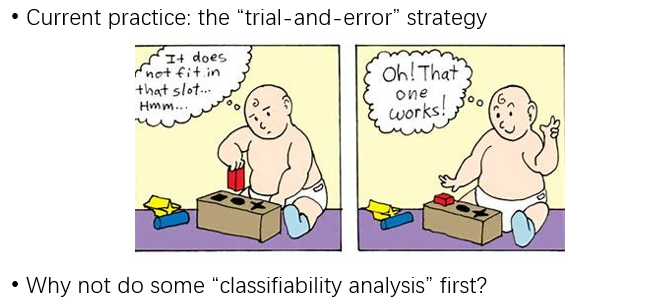

In many data-driven discriminative tasks, without specific priori knowledge, scientists often start with popular classifier models in machine learning. If works, bingo! A happy ending. the alorithm can be deployed into production and the researcch get published. Otherwise, continue to try other more sophisticated model. If all major models fail, we have to turn to other detection modalities, which usually mean the modality generating the current data set doesn't capture the information we need for the task.

A fundamental question beneath the above "trial and error" (Trial and error is a fundamental method of problem solving. It is characterised by repeated, varied attempts which are continued until success, or until the practicer stops trying) practice:   
`Does the dataset possess the statistical differences between different groups/classes?` or `Are the samples drawn from different distributions (generation processes)?`

This reveals an implicit and often neglected pre-assessment step in the entire pipeline: the dataset classifiability analysis

### Related work: A unified classifiability analysis framework based on meta-learner and its application in spectroscopic profiling data [J]. Applied Intelligence, 2021, doi: 10.1007/s10489-021-02810-8

Propose a framework based on multiple metrics to evaluate the degree of classifibility of data X on category information Y.

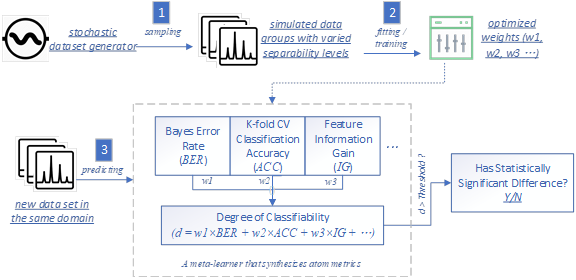

# Atom metrics (currently support 90+ metrics, here only list a few):

## Metric 1: Bayes Error Rate

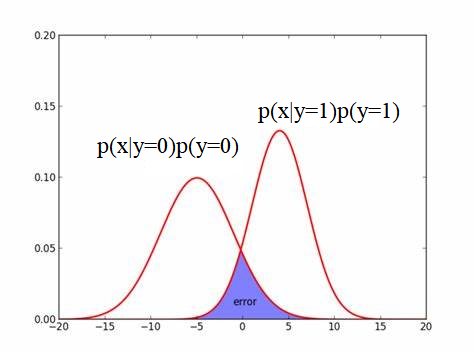

$$ BER= 1- E ({\max}_j P(Y=j|X) $$

It is the lowest possible test error rate in classification which is produced by the Bayes classifier. It is analogous to the irreducible error rate.  

Because of noise (inherently stochastic), the error incurred by the oracle prediction model from the true distribution p(x,y) is the Bayes error.

To calculate BER, we can use the Gaussian Bayes model, based on the naive assumption:   
The features (in this case, PCs returned from PCA in the latent space) conform to Multivariate Gaussian Distributions.  
Each class corresponds to one Gaussian distribution.    

The Bayes optimal decision boundary will correspond to the point where two densities are equal. 


### Why is this Guassian assumption reasonable for spectroscopic data?

According to the central limit theorem (CLT), if a statistic is a sum or average of repetitive measurements, it will be approximately normal under certain technical conditions regardless of the distribution of the individual samples.
Each wave number in Raman or tof in ms, from physical process, is a an accumulation of measurement of photons/ions/particles. 
Features are uncorreleted. In micro level, physical process, photons/ions/particles of different frequency/energy/mass/electric charge don't interfere with each other. 
The coocurrence / correlation between features is a macro relation. i.e., Peak patterns. 

Optional: check feature normality, e.g., by Q-Q plot 


### Implementation

To calculate BER, we can either use: 
1. We need to integrate over the density that is not the highest one for each point. As there are two densities, we need to sum up the two integrals. We can use numerical integration package, e.g. `scipy.integrate`

2. use Gaussian NB classifier, e.g. `sklearn.naive_bayes.GaussianNB`  
`predict_proba()` returns the probability of the samples for each class in the model

## Metric2: Classification Accuracy

Choose SVM (support vector machine) as the base model and use K-fold CV (cross-validation) to pick up the best model.   
CV ensures the classifier has a proper generalization capability (neither underfit or overfit)

## Metric 3: info-gain 

Information gain has been used in decision tree. For a specific feature, Information gain (IG) measures how much “information” a feature gives us about the class.

$IG(Y|X) = H(Y) - H(Y|X) $  

In information theory, IG answers "if we transmit Y, how many bits can be saved if both sender and receiver know X?" Or "how much information of Y is implied in X?"

Attribute/feature X with a high IG is a good split on Y.

### Implementation

It can be proven that `Info Gain = Mutual information`  
We can use `mutual_info_classif` to calculate info gain.      

Be cautious about the `discrete_features` parameter : {‘auto’, bool, array_like}, default ‘auto’

    If bool, then determines whether to consider all features discrete or continuous. If array, then it should be either a boolean mask with shape (n_features,) or array with indices of discrete features. If ‘auto’, it is assigned to False for dense X and to True for sparse X.  
    
For continous feature, use `discrete_features = False`.


Notes

    The term “discrete features” is used instead of naming them “categorical”, because it describes the essence more accurately. For example, pixel intensities of an image are discrete features (but hardly categorical) and you will get better results if mark them as such. Also note, that treating a continuous variable as discrete and vice versa will usually give incorrect results, so be attentive about that.
    True mutual information can’t be negative. If its estimate turns out to be negative, it is replaced by zero.


In [1]:
import qsi
import cla

print("qsi-tk " + qsi.__version__)
print("cla " + cla.__version__)

%matplotlib inline

# import warnings
# warnings.filterwarnings("ignore")

qsi-tk 1.0.6
cla 2.1.0


# Generate multi-dimensional datasets at different between-class distances

d as a multi-var version of Cohen's d effect size. 
Use simulated datasets to demostrate d

rpy2 3.X may not support Windows. ECoL metrics may not be available.


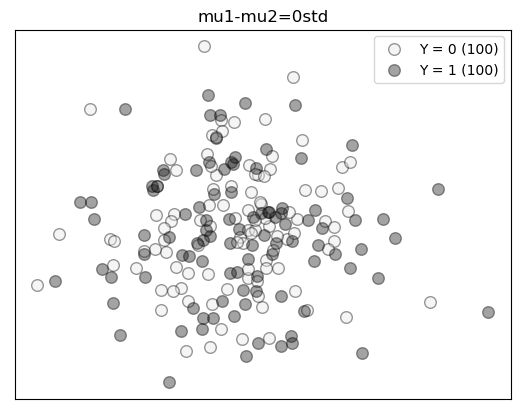

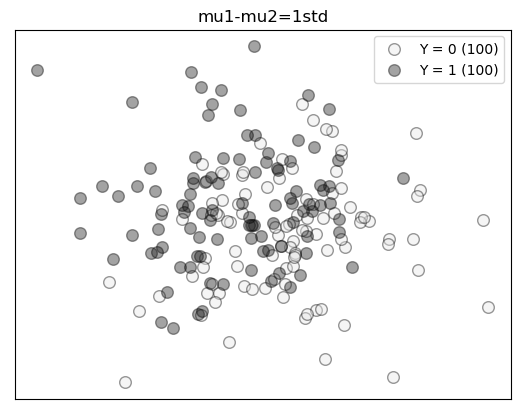

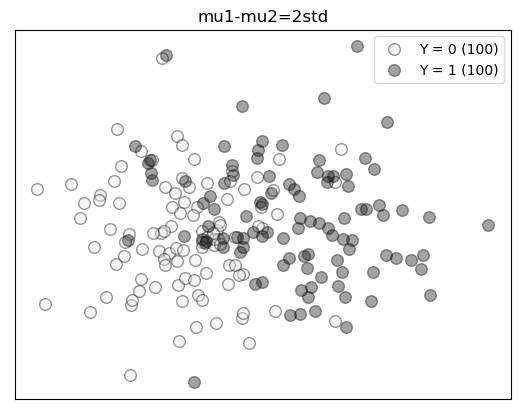

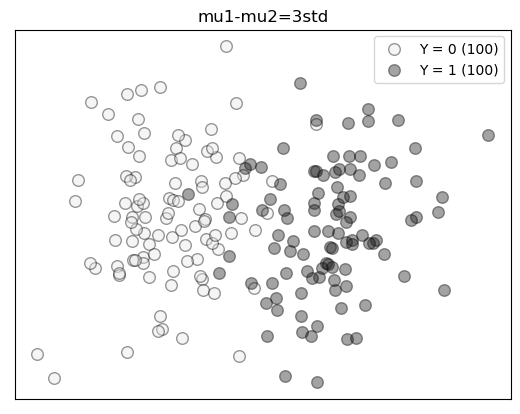

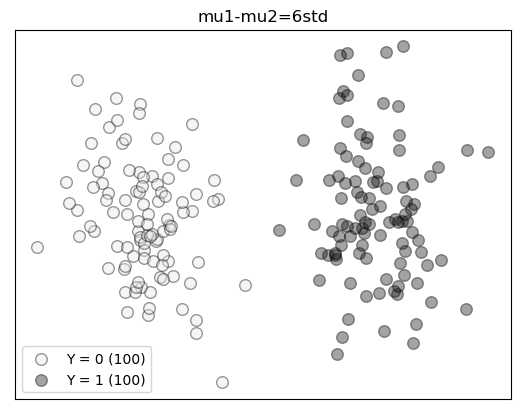

In [2]:
import cla.metrics
import matplotlib
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

matplotlib.rcParams.update({'font.size': 10})

for md in [0, 1, 2, 3, 6]:

    X,y = cla.metrics.mvg(
        nobs = 100, # number of observations / samples
        md = md # distance between means, respect to std, i.e. (mu2 - mu1) / std, or how many stds is the difference.
        )

    X_pca = PCA(n_components = 2).fit_transform(X)
    cla.metrics.plotComponents2D(X_pca, y)
    plt.title('mu1-mu2='+str(md)+'std')
    plt.show()

md = 2 or 3 may be the lowest decent choice for separability cutoff. We need this cutoff to produce binary values for logistic meta learners, etc.

# Test with real dataset

load dataset from vintage_7344_Y5Y26.csv
X.shape (121, 2089)  y.shape (121,)


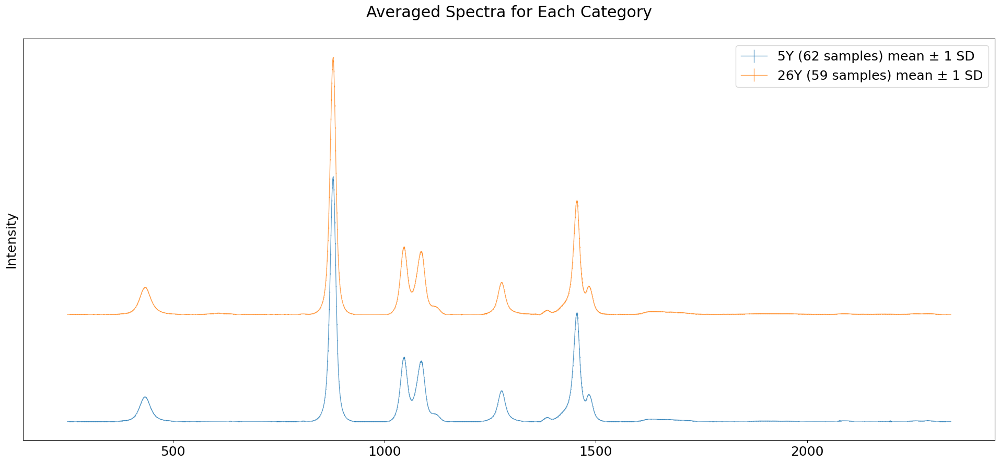

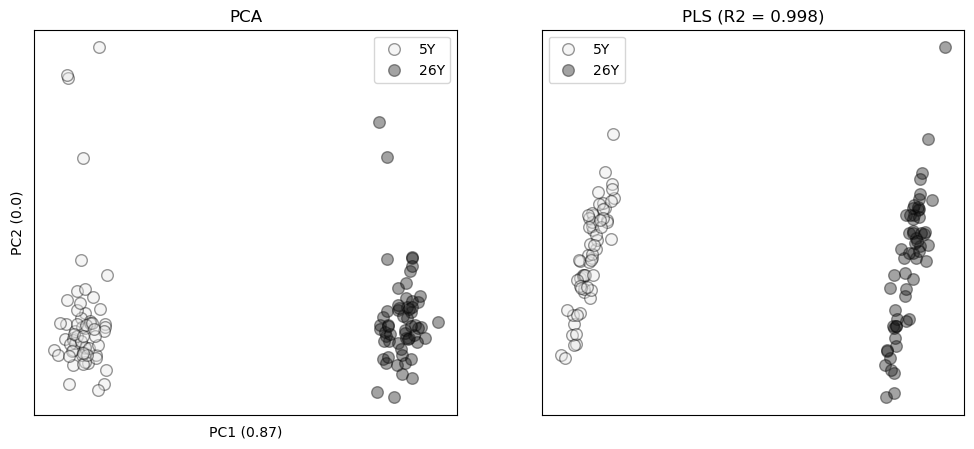

7344_Y5Y26.csv - Raman spectroscopic profiling dataset of 
5-year and 26-year Gujing Tribute vintage liquors. 

With a long history, Gujing Tribute Liquor with fragrant taste is one of the eight most famous liquors in China. In 196AD, Cao Cao presented the "Jiuyun Spring Liquor" that was produced in his hometown as the royal liquor, as well as its brewing methods to the Emperor Xian of Han Dynasty. During the Wan Li Reign of Ming Dynasty, it was presented to the royal court as a "tribute" all the way until Qing Dynasty, hence the liquor is named "Gujing Tribute Liquor" . On the basis of traditional processes, it has scientific recipes and technological innovations. It features "crystal clear, sweet and mellow like orchid, velvety and lasting after tasting" and brings a unique taste known for its sweetness, aroma and full flavor. It was awarded the gold medal of the national liquor-tasting conference for four times, and won the title of "National Famous Liquor". In March 2003, it was in

窗函数预处理（max）: binning window width =  1 / 0.1 = 10


In [3]:
from qsi import io, pipeline
X,y,X_names,_,y_names = io.load_dataset("vintage_526", shift = 3000)
X, X_names = pipeline.preprocess_dataset(X, X_names, pres = [('max', 0.1)])
# X, X_names = io.pre.x_binning(X, X_names, target_dim=0.1, flavor='max')

Optional preprocessing steps 

### Feature selection via ElasticNet  

1. Reduce dimension and remove unrelavent features for the classification problem
2. reduce the overfitting risk of successive classification model. Improve the generalization
3. By selecting only a few bunch of features, easier to interpret its chemcial meansings. i.e. gain a better understanding of the features and easy to notice  the co-ocurrance of multiple variables (important for Raman, as one bond or molecule have muliptle peaks).

Highly recommendated for high-dimensional physio-chemical spectroscopic data, e.g., Raman and MALDI-TOF.

### Dimensionality Reduction via PCA

Priori knowledge: The Raman spectrum data only contains additive or linear structures (each chemical bond or particle corresponds to several wave numbers), but no complex embedding structures. So non-linear dimensionality reduction methods, such as kernel PCA, LLE, t-SNE, do not suit. 

### Feature Scaling

Coefficients from LASSO or ElasticNet depend on the magnitude of each variable. It is therefore necessary to rescale, or standardize, the variables.  
The result of centering the variables means that there is no longer an intercept.

Without feature scaling, the feature selection result can be quite different!

  0%|                                                                                           | 0/48 [00:00<?, ?it/s]Exception ignored from cffi callback <function _consolewrite_ex at 0x0000027CE8B3A700>:
Traceback (most recent call last):
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte


2023-08-26 16:43:30,323 - WARNING - R[write to console]: In addition: 
2023-08-26 16:43:30,323 - WARNING - R[write to console]: Warning message:

2023-08-26 16:43:30,323 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:43:30,323 - WARNING - R[write to console]: 
 
2023-08-26 16:43:30,323 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



  2%|█▋                                                                                 | 1/48 [00:23<18:43, 23.90s/it]

2023-08-26 16:43:52,402 - WARNING - R[write to console]: In addition: 
2023-08-26 16:43:52,402 - WARNING - R[write to console]: Warning message:

2023-08-26 16:43:52,402 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:43:52,402 - WARNING - R[write to console]: 
 
2023-08-26 16:43:52,402 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



  4%|███▍                                                                               | 2/48 [00:45<17:30, 22.83s/it]

2023-08-26 16:44:13,651 - WARNING - R[write to console]: In addition: 
2023-08-26 16:44:13,651 - WARNING - R[write to console]: Warning message:

2023-08-26 16:44:13,651 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:44:13,651 - WARNING - R[write to console]: 
 
2023-08-26 16:44:13,651 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



  6%|█████▏                                                                             | 3/48 [01:07<16:34, 22.11s/it]

2023-08-26 16:44:34,508 - WARNING - R[write to console]: In addition: 
2023-08-26 16:44:34,508 - WARNING - R[write to console]: Warning message:

2023-08-26 16:44:34,508 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:44:34,508 - WARNING - R[write to console]: 
 
2023-08-26 16:44:34,508 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



  8%|██████▉                                                                            | 4/48 [01:28<15:50, 21.61s/it]

2023-08-26 16:44:55,379 - WARNING - R[write to console]: In addition: 
2023-08-26 16:44:55,379 - WARNING - R[write to console]: Warning message:

2023-08-26 16:44:55,379 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:44:55,379 - WARNING - R[write to console]: 
 
2023-08-26 16:44:55,379 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 10%|████████▋                                                                          | 5/48 [01:48<15:17, 21.35s/it]

2023-08-26 16:45:16,938 - WARNING - R[write to console]: In addition: 
2023-08-26 16:45:16,938 - WARNING - R[write to console]: Warning message:

2023-08-26 16:45:16,938 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:45:16,938 - WARNING - R[write to console]: 
 
2023-08-26 16:45:16,938 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 12%|██████████▍                                                                        | 6/48 [02:10<14:59, 21.42s/it]

2023-08-26 16:45:36,020 - WARNING - R[write to console]: In addition: 
2023-08-26 16:45:36,020 - WARNING - R[write to console]: Warning message:

2023-08-26 16:45:36,020 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:45:36,020 - WARNING - R[write to console]: 
 
2023-08-26 16:45:36,020 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 15%|████████████                                                                       | 7/48 [02:29<14:06, 20.65s/it]

2023-08-26 16:45:55,969 - WARNING - R[write to console]: In addition: 
2023-08-26 16:45:55,969 - WARNING - R[write to console]: Warning message:

2023-08-26 16:45:55,969 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:45:55,969 - WARNING - R[write to console]: 
 
2023-08-26 16:45:55,969 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 17%|█████████████▊                                                                     | 8/48 [02:49<13:37, 20.43s/it]

2023-08-26 16:46:16,258 - WARNING - R[write to console]: In addition: 
2023-08-26 16:46:16,258 - WARNING - R[write to console]: Warning message:

2023-08-26 16:46:16,258 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:46:16,258 - WARNING - R[write to console]: 
 
2023-08-26 16:46:16,258 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 19%|███████████████▌                                                                   | 9/48 [03:09<13:15, 20.39s/it]

2023-08-26 16:46:33,976 - WARNING - R[write to console]: In addition: 
2023-08-26 16:46:33,976 - WARNING - R[write to console]: Warning message:

2023-08-26 16:46:33,976 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:46:33,976 - WARNING - R[write to console]: 
 
2023-08-26 16:46:33,991 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 21%|█████████████████                                                                 | 10/48 [03:27<12:23, 19.57s/it]

2023-08-26 16:46:53,846 - WARNING - R[write to console]: In addition: 
2023-08-26 16:46:53,846 - WARNING - R[write to console]: Warning message:

2023-08-26 16:46:53,861 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:46:53,861 - WARNING - R[write to console]: 
 
2023-08-26 16:46:53,861 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 23%|██████████████████▊                                                               | 11/48 [03:47<12:07, 19.66s/it]

2023-08-26 16:47:15,005 - WARNING - R[write to console]: In addition: 
2023-08-26 16:47:15,005 - WARNING - R[write to console]: Warning message:

2023-08-26 16:47:15,005 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:47:15,005 - WARNING - R[write to console]: 
 
2023-08-26 16:47:15,005 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 25%|████████████████████▌                                                             | 12/48 [04:08<12:04, 20.11s/it]

2023-08-26 16:47:33,645 - WARNING - R[write to console]: In addition: 
2023-08-26 16:47:33,645 - WARNING - R[write to console]: Warning message:

2023-08-26 16:47:33,645 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:47:33,645 - WARNING - R[write to console]: 
 
2023-08-26 16:47:33,645 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 27%|██████████████████████▏                                                           | 13/48 [04:27<11:28, 19.66s/it]

2023-08-26 16:47:53,980 - WARNING - R[write to console]: In addition: 
2023-08-26 16:47:53,980 - WARNING - R[write to console]: Warning message:

2023-08-26 16:47:53,980 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:47:53,980 - WARNING - R[write to console]: 
 
2023-08-26 16:47:53,980 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 29%|███████████████████████▉                                                          | 14/48 [04:47<11:15, 19.87s/it]

2023-08-26 16:48:11,651 - WARNING - R[write to console]: In addition: 
2023-08-26 16:48:11,651 - WARNING - R[write to console]: Warning message:

2023-08-26 16:48:11,651 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:48:11,651 - WARNING - R[write to console]: 
 
2023-08-26 16:48:11,651 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 31%|█████████████████████████▋                                                        | 15/48 [05:05<10:33, 19.20s/it]

2023-08-26 16:48:29,182 - WARNING - R[write to console]: In addition: 
2023-08-26 16:48:29,182 - WARNING - R[write to console]: Warning message:

2023-08-26 16:48:29,182 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:48:29,182 - WARNING - R[write to console]: 
 
2023-08-26 16:48:29,182 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 33%|███████████████████████████▎                                                      | 16/48 [05:22<09:58, 18.70s/it]

2023-08-26 16:48:46,901 - WARNING - R[write to console]: In addition: 
2023-08-26 16:48:46,901 - WARNING - R[write to console]: Warning message:

2023-08-26 16:48:46,901 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:48:46,901 - WARNING - R[write to console]: 
 
2023-08-26 16:48:46,901 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 35%|█████████████████████████████                                                     | 17/48 [05:40<09:30, 18.40s/it]

2023-08-26 16:49:05,452 - WARNING - R[write to console]: In addition: 
2023-08-26 16:49:05,452 - WARNING - R[write to console]: Warning message:

2023-08-26 16:49:05,452 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:49:05,467 - WARNING - R[write to console]: 
 
2023-08-26 16:49:05,467 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 38%|██████████████████████████████▊                                                   | 18/48 [05:59<09:13, 18.45s/it]

2023-08-26 16:49:22,699 - WARNING - R[write to console]: In addition: 
2023-08-26 16:49:22,699 - WARNING - R[write to console]: Warning message:

2023-08-26 16:49:22,699 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:49:22,699 - WARNING - R[write to console]: 
 
2023-08-26 16:49:22,699 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 40%|████████████████████████████████▍                                                 | 19/48 [06:16<08:44, 18.09s/it]

2023-08-26 16:49:40,009 - WARNING - R[write to console]: In addition: 
2023-08-26 16:49:40,009 - WARNING - R[write to console]: Warning message:

2023-08-26 16:49:40,009 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:49:40,009 - WARNING - R[write to console]: 
 
2023-08-26 16:49:40,009 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 42%|██████████████████████████████████▏                                               | 20/48 [06:33<08:19, 17.85s/it]

2023-08-26 16:49:58,396 - WARNING - R[write to console]: In addition: 
2023-08-26 16:49:58,396 - WARNING - R[write to console]: Warning message:

2023-08-26 16:49:58,412 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:49:58,412 - WARNING - R[write to console]: 
 
2023-08-26 16:49:58,412 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 44%|███████████████████████████████████▉                                              | 21/48 [06:51<08:06, 18.02s/it]

2023-08-26 16:50:17,525 - WARNING - R[write to console]: In addition: 
2023-08-26 16:50:17,525 - WARNING - R[write to console]: Warning message:

2023-08-26 16:50:17,525 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:50:17,525 - WARNING - R[write to console]: 
 
2023-08-26 16:50:17,525 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 46%|█████████████████████████████████████▌                                            | 22/48 [07:11<07:57, 18.35s/it]

2023-08-26 16:50:34,883 - WARNING - R[write to console]: In addition: 
2023-08-26 16:50:34,883 - WARNING - R[write to console]: Warning message:

2023-08-26 16:50:34,883 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:50:34,883 - WARNING - R[write to console]: 
 
2023-08-26 16:50:34,883 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 48%|███████████████████████████████████████▎                                          | 23/48 [07:28<07:31, 18.05s/it]

2023-08-26 16:50:52,039 - WARNING - R[write to console]: In addition: 
2023-08-26 16:50:52,039 - WARNING - R[write to console]: Warning message:

2023-08-26 16:50:52,039 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:50:52,039 - WARNING - R[write to console]: 
 
2023-08-26 16:50:52,039 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 50%|█████████████████████████████████████████                                         | 24/48 [07:45<07:06, 17.78s/it]

2023-08-26 16:51:09,540 - WARNING - R[write to console]: In addition: 
2023-08-26 16:51:09,540 - WARNING - R[write to console]: Warning message:

2023-08-26 16:51:09,540 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:51:09,540 - WARNING - R[write to console]: 
 
2023-08-26 16:51:09,540 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 52%|██████████████████████████████████████████▋                                       | 25/48 [08:03<06:47, 17.70s/it]

2023-08-26 16:51:26,490 - WARNING - R[write to console]: In addition: 
2023-08-26 16:51:26,490 - WARNING - R[write to console]: Warning message:

2023-08-26 16:51:26,490 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:51:26,490 - WARNING - R[write to console]: 
 
2023-08-26 16:51:26,490 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 54%|████████████████████████████████████████████▍                                     | 26/48 [08:20<06:24, 17.47s/it]

2023-08-26 16:51:46,137 - WARNING - R[write to console]: In addition: 
2023-08-26 16:51:46,137 - WARNING - R[write to console]: Warning message:

2023-08-26 16:51:46,137 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:51:46,137 - WARNING - R[write to console]: 
 
2023-08-26 16:51:46,137 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 56%|██████████████████████████████████████████████▏                                   | 27/48 [08:39<06:20, 18.13s/it]

2023-08-26 16:52:03,745 - WARNING - R[write to console]: In addition: 
2023-08-26 16:52:03,745 - WARNING - R[write to console]: Warning message:

2023-08-26 16:52:03,745 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:52:03,745 - WARNING - R[write to console]: 
 
2023-08-26 16:52:03,745 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 58%|███████████████████████████████████████████████▊                                  | 28/48 [08:57<05:59, 17.97s/it]

2023-08-26 16:52:20,788 - WARNING - R[write to console]: In addition: 
2023-08-26 16:52:20,788 - WARNING - R[write to console]: Warning message:

2023-08-26 16:52:20,788 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:52:20,788 - WARNING - R[write to console]: 
 
2023-08-26 16:52:20,788 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 60%|█████████████████████████████████████████████████▌                                | 29/48 [09:14<05:36, 17.69s/it]

2023-08-26 16:52:38,085 - WARNING - R[write to console]: In addition: 
2023-08-26 16:52:38,085 - WARNING - R[write to console]: Warning message:

2023-08-26 16:52:38,085 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:52:38,085 - WARNING - R[write to console]: 
 
2023-08-26 16:52:38,085 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 62%|███████████████████████████████████████████████████▎                              | 30/48 [09:31<05:16, 17.57s/it]

2023-08-26 16:52:55,458 - WARNING - R[write to console]: In addition: 
2023-08-26 16:52:55,458 - WARNING - R[write to console]: Warning message:

2023-08-26 16:52:55,458 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:52:55,458 - WARNING - R[write to console]: 
 
2023-08-26 16:52:55,458 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 65%|████████████████████████████████████████████████████▉                             | 31/48 [09:49<04:57, 17.51s/it]

2023-08-26 16:53:12,440 - WARNING - R[write to console]: In addition: 
2023-08-26 16:53:12,440 - WARNING - R[write to console]: Warning message:

2023-08-26 16:53:12,440 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:53:12,440 - WARNING - R[write to console]: 
 
2023-08-26 16:53:12,440 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 67%|██████████████████████████████████████████████████████▋                           | 32/48 [10:06<04:37, 17.35s/it]

2023-08-26 16:53:32,417 - WARNING - R[write to console]: In addition: 
2023-08-26 16:53:32,417 - WARNING - R[write to console]: Warning message:

2023-08-26 16:53:32,417 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:53:32,417 - WARNING - R[write to console]: 
 
2023-08-26 16:53:32,417 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 69%|████████████████████████████████████████████████████████▍                         | 33/48 [10:25<04:32, 18.14s/it]

2023-08-26 16:53:49,821 - WARNING - R[write to console]: In addition: 
2023-08-26 16:53:49,821 - WARNING - R[write to console]: Warning message:

2023-08-26 16:53:49,821 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:53:49,837 - WARNING - R[write to console]: 
 
2023-08-26 16:53:49,837 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 71%|██████████████████████████████████████████████████████████                        | 34/48 [10:43<04:10, 17.92s/it]

2023-08-26 16:54:06,927 - WARNING - R[write to console]: In addition: 
2023-08-26 16:54:06,927 - WARNING - R[write to console]: Warning message:

2023-08-26 16:54:06,927 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:54:06,927 - WARNING - R[write to console]: 
 
2023-08-26 16:54:06,927 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 73%|███████████████████████████████████████████████████████████▊                      | 35/48 [11:00<03:49, 17.67s/it]

2023-08-26 16:54:23,957 - WARNING - R[write to console]: In addition: 
2023-08-26 16:54:23,957 - WARNING - R[write to console]: Warning message:

2023-08-26 16:54:23,957 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:54:23,957 - WARNING - R[write to console]: 
 
2023-08-26 16:54:23,957 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 75%|█████████████████████████████████████████████████████████████▌                    | 36/48 [11:17<03:29, 17.48s/it]

2023-08-26 16:54:40,870 - WARNING - R[write to console]: In addition: 
2023-08-26 16:54:40,870 - WARNING - R[write to console]: Warning message:

2023-08-26 16:54:40,870 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:54:40,876 - WARNING - R[write to console]: 
 
2023-08-26 16:54:40,876 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 77%|███████████████████████████████████████████████████████████████▏                  | 37/48 [11:34<03:10, 17.31s/it]

2023-08-26 16:54:58,249 - WARNING - R[write to console]: In addition: 
2023-08-26 16:54:58,249 - WARNING - R[write to console]: Warning message:

2023-08-26 16:54:58,249 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:54:58,249 - WARNING - R[write to console]: 
 
2023-08-26 16:54:58,249 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 79%|████████████████████████████████████████████████████████████████▉                 | 38/48 [11:51<02:53, 17.34s/it]

2023-08-26 16:55:15,430 - WARNING - R[write to console]: In addition: 
2023-08-26 16:55:15,430 - WARNING - R[write to console]: Warning message:

2023-08-26 16:55:15,430 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:55:15,434 - WARNING - R[write to console]: 
 
2023-08-26 16:55:15,434 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 81%|██████████████████████████████████████████████████████████████████▋               | 39/48 [12:09<02:35, 17.29s/it]

2023-08-26 16:55:35,489 - WARNING - R[write to console]: In addition: 
2023-08-26 16:55:35,489 - WARNING - R[write to console]: Warning message:

2023-08-26 16:55:35,489 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:55:35,489 - WARNING - R[write to console]: 
 
2023-08-26 16:55:35,489 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 83%|████████████████████████████████████████████████████████████████████▎             | 40/48 [12:29<02:24, 18.12s/it]

2023-08-26 16:55:52,862 - WARNING - R[write to console]: In addition: 
2023-08-26 16:55:52,862 - WARNING - R[write to console]: Warning message:

2023-08-26 16:55:52,862 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:55:52,862 - WARNING - R[write to console]: 
 
2023-08-26 16:55:52,862 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 85%|██████████████████████████████████████████████████████████████████████            | 41/48 [12:46<02:05, 17.89s/it]

2023-08-26 16:56:09,937 - WARNING - R[write to console]: In addition: 
2023-08-26 16:56:09,937 - WARNING - R[write to console]: Warning message:

2023-08-26 16:56:09,937 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:56:09,937 - WARNING - R[write to console]: 
 
2023-08-26 16:56:09,937 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 88%|███████████████████████████████████████████████████████████████████████▊          | 42/48 [13:03<01:45, 17.65s/it]

2023-08-26 16:56:26,967 - WARNING - R[write to console]: In addition: 
2023-08-26 16:56:26,967 - WARNING - R[write to console]: Warning message:

2023-08-26 16:56:26,967 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:56:26,967 - WARNING - R[write to console]: 
 
2023-08-26 16:56:26,967 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 90%|█████████████████████████████████████████████████████████████████████████▍        | 43/48 [13:20<01:27, 17.46s/it]

2023-08-26 16:56:44,277 - WARNING - R[write to console]: In addition: 
2023-08-26 16:56:44,277 - WARNING - R[write to console]: Warning message:

2023-08-26 16:56:44,277 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:56:44,277 - WARNING - R[write to console]: 
 
2023-08-26 16:56:44,277 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 92%|███████████████████████████████████████████████████████████████████████████▏      | 44/48 [13:37<01:09, 17.42s/it]

2023-08-26 16:57:01,258 - WARNING - R[write to console]: In addition: 
2023-08-26 16:57:01,258 - WARNING - R[write to console]: Warning message:

2023-08-26 16:57:01,258 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:57:01,258 - WARNING - R[write to console]: 
 
2023-08-26 16:57:01,258 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 94%|████████████████████████████████████████████████████████████████████████████▉     | 45/48 [13:54<00:51, 17.29s/it]

2023-08-26 16:57:18,506 - WARNING - R[write to console]: In addition: 
2023-08-26 16:57:18,506 - WARNING - R[write to console]: Warning message:

2023-08-26 16:57:18,506 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:57:18,521 - WARNING - R[write to console]: 
 
2023-08-26 16:57:18,521 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 96%|██████████████████████████████████████████████████████████████████████████████▌   | 46/48 [14:12<00:34, 17.28s/it]

2023-08-26 16:57:36,211 - WARNING - R[write to console]: In addition: 
2023-08-26 16:57:36,211 - WARNING - R[write to console]: Warning message:

2023-08-26 16:57:36,211 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:57:36,211 - WARNING - R[write to console]: 
 
2023-08-26 16:57:36,211 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



 98%|████████████████████████████████████████████████████████████████████████████████▎ | 47/48 [14:29<00:17, 17.41s/it]

2023-08-26 16:57:53,504 - WARNING - R[write to console]: In addition: 
2023-08-26 16:57:53,507 - WARNING - R[write to console]: Warning message:

2023-08-26 16:57:53,507 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-26 16:57:53,507 - WARNING - R[write to console]: 
 
2023-08-26 16:57:53,507 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases



100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [14:47<00:00, 17.37s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.533,0.708,0.875,0.967,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,0.067,0.417,0.75,0.933,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.533,0.708,0.875,0.967,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.365,0.552,0.778,0.937,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.533,0.708,0.875,0.967,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.533,0.708,0.875,0.967,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.602,1.0,0.297,0.32,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,0.321,0.0,1.872,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.581,0.766,0.162,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,0.533,0.09,3.222,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [14:51<00:00, 18.57s/it]


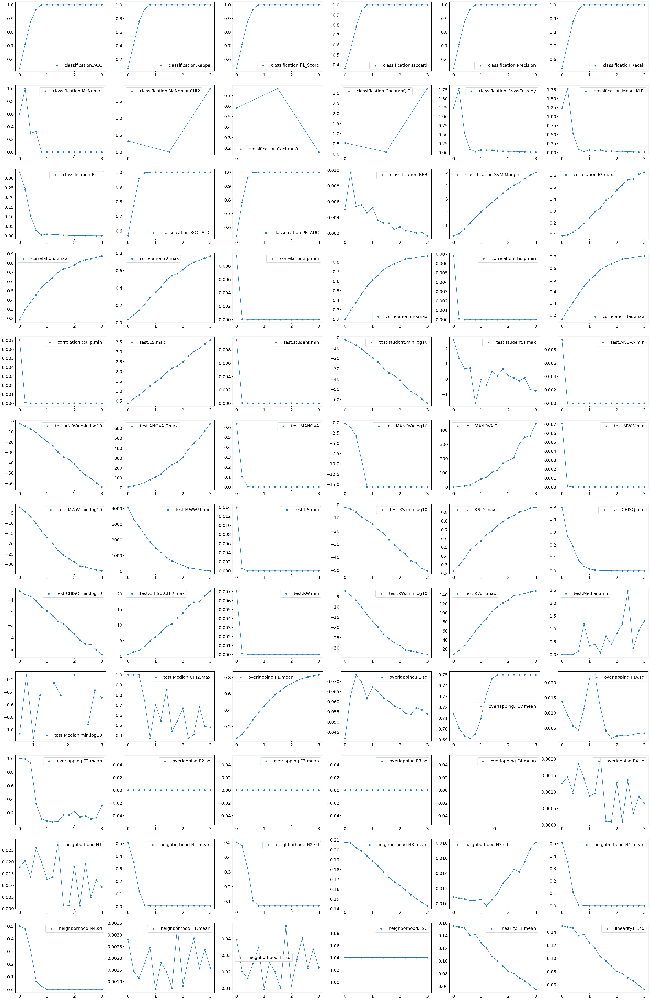

In [4]:
from cla.unify import calculate_atom_metrics
from cla.metrics import visualize_atom_dict
import numpy as np
dic = calculate_atom_metrics(mu = X.mean(axis = 0), s = X.std(axis = 0),
                             mds = np.linspace(0, 3, 4+3*4),
                             # repeat = 5, nobs = 100, 
                             show_html = True)

visualize_atom_dict(dic)

根据上述响应曲线，选择以下线性相关性好的指标。

before filter


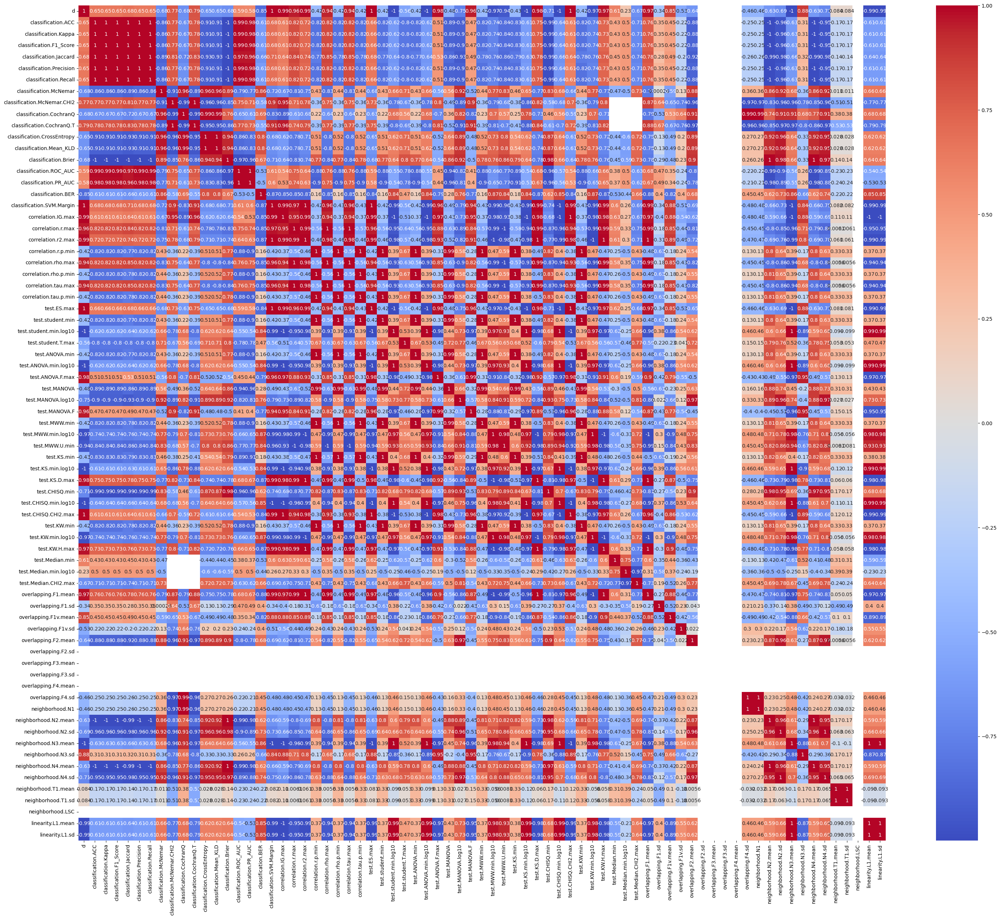

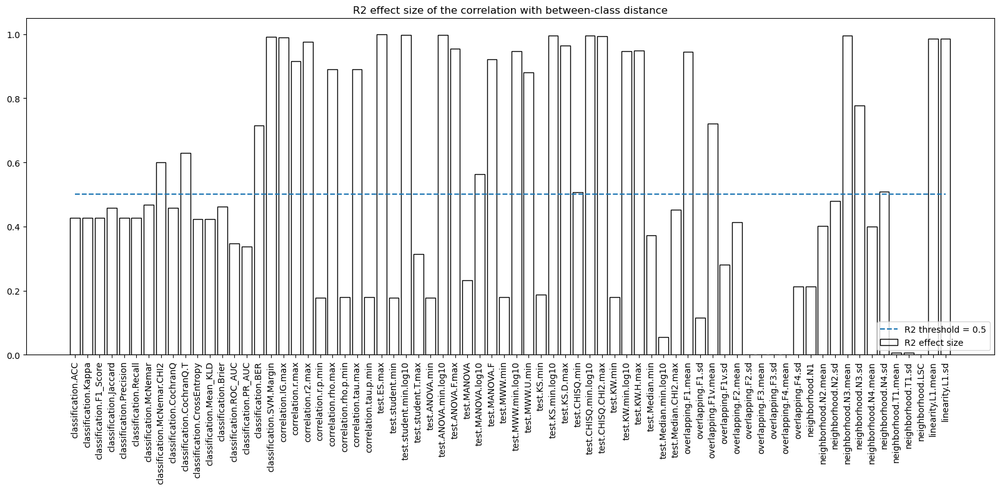

Metrics above the threshold (0.5):  ['classification.McNemar.CHI2' 'classification.CochranQ.T'
 'classification.BER' 'classification.SVM.Margin' 'correlation.IG.max'
 'correlation.r.max' 'correlation.r2.max' 'correlation.rho.max'
 'correlation.tau.max' 'test.ES.max' 'test.student.min.log10'
 'test.ANOVA.min.log10' 'test.ANOVA.F.max' 'test.MANOVA.log10'
 'test.MANOVA.F' 'test.MWW.min.log10' 'test.MWW.U.min' 'test.KS.min.log10'
 'test.KS.D.max' 'test.CHISQ.min' 'test.CHISQ.min.log10'
 'test.CHISQ.CHI2.max' 'test.KW.min.log10' 'test.KW.H.max'
 'overlapping.F1.mean' 'overlapping.F1v.mean' 'neighborhood.N3.mean'
 'neighborhood.N3.sd' 'neighborhood.N4.sd' 'linearity.L1.mean'
 'linearity.L1.sd']


In [5]:
from cla.unify import filter_metrics
dic_r2, keys, filtered_dic, M = filter_metrics(dic, threshold = 0.5)

In [6]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
M = scaler.fit_transform(M)

# train meta-learner

In [7]:
from cla.unify import train_metalearner_logistic
model = train_metalearner_logistic(M, dic['d'], cutoff=2)

# analyze between-class and in-class classifiability using meta.logistic

In [8]:
from cla.unify import calculate_unified_metric
calculate_unified_metric(X, y, model, keys, method = 'meta.logistic', scaler = scaler)

2023-08-26 16:58:33,787 - WARNING - R[write to console]: In addition: 
2023-08-26 16:58:33,787 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-26 16:58:33,787 - WARNING - R[write to console]: 

2023-08-26 16:58:45,029 - WARNING - R[write to console]: In addition: 
2023-08-26 16:58:45,045 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-26 16:58:45,045 - WARNING - R[write to console]: 

2023-08-26 16:58:56,523 - WARNING - R[write to console]: In addition: 
2023-08-26 16:58:56,523 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-26 16:58:56,523 - WARNING - R[write to console]: 

2023-08-26 16:59:08,110 - WARNING - R[write to console]: In addition: 
2023-08-26 16:59:08,110 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-26 16:59:08,110 - WARNING - R[w

(0.9928594986200179, [1.1640701854974257e-05, 2.920487093673614e-06])

<br/>

<hr/>

# Let's put them together and run all case studies

rpy2 3.X may not support Windows. ECoL metrics may not be available.


load dataset from vintage_7344_Y5Y26.csv
X.shape (121, 2089)  y.shape (121,)
7344_Y5Y26.csv - Raman spectroscopic profiling dataset of 
5-year and 26-year Gujing Tribute vintage liquors. 

With a long history, Gujing Tribute Liquor with fragrant taste is one of the eight most famous liquors in China. In 196AD, Cao Cao presented the "Jiuyun Spring Liquor" that was produced in his hometown as the royal liquor, as well as its brewing methods to the Emperor Xian of Han Dynasty. During the Wan Li Reign of Ming Dynasty, it was presented to the royal court as a "tribute" all the way until Qing Dynasty, hence the liquor is named "Gujing Tribute Liquor" . On the basis of traditional processes, it has scientific recipes and technological innovations. It features "crystal clear, sweet and mellow like orchid, velvety and lasting after tasting" and brings a unique taste known for its sweetness, aroma and full flavor. It was awarded the gold medal of the national liquor-tasting conference for four t

窗函数预处理（max）: binning window width =  1 / 0.1 = 10


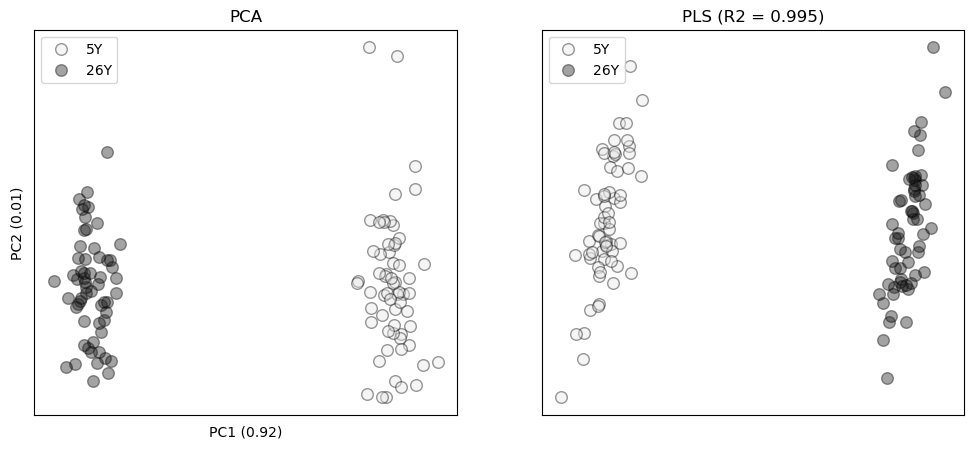

  0%|                                                                                           | 0/48 [00:00<?, ?it/s]Exception ignored from cffi callback <function _consolewrite_ex at 0x00000208B1E9AD30>:
Traceback (most recent call last):
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte
100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [23:56<00:00, 62.26s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.497,0.673,0.878,0.986,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,-0.007,0.345,0.755,0.973,0.986,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.497,0.673,0.878,0.986,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.33,0.513,0.783,0.973,0.987,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.497,0.673,0.878,0.986,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.497,0.673,0.878,0.986,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.739,0.579,0.52,0.667,0.333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,0.121,0.447,0.625,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.593,0.57,0.3,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,0.296,0.698,1.389,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827001227.062189.pkl


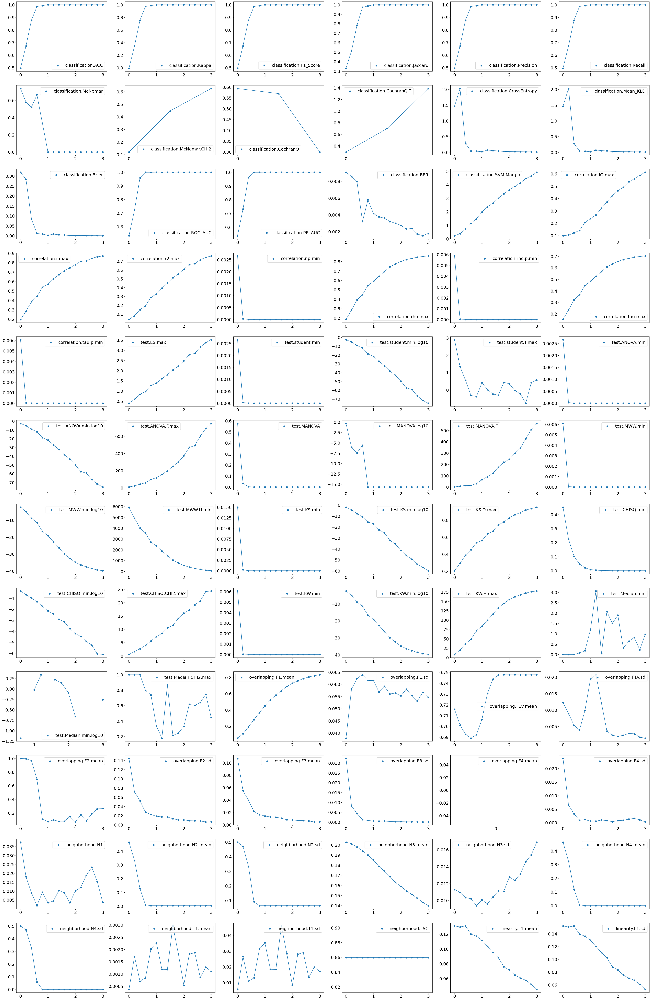

before filter


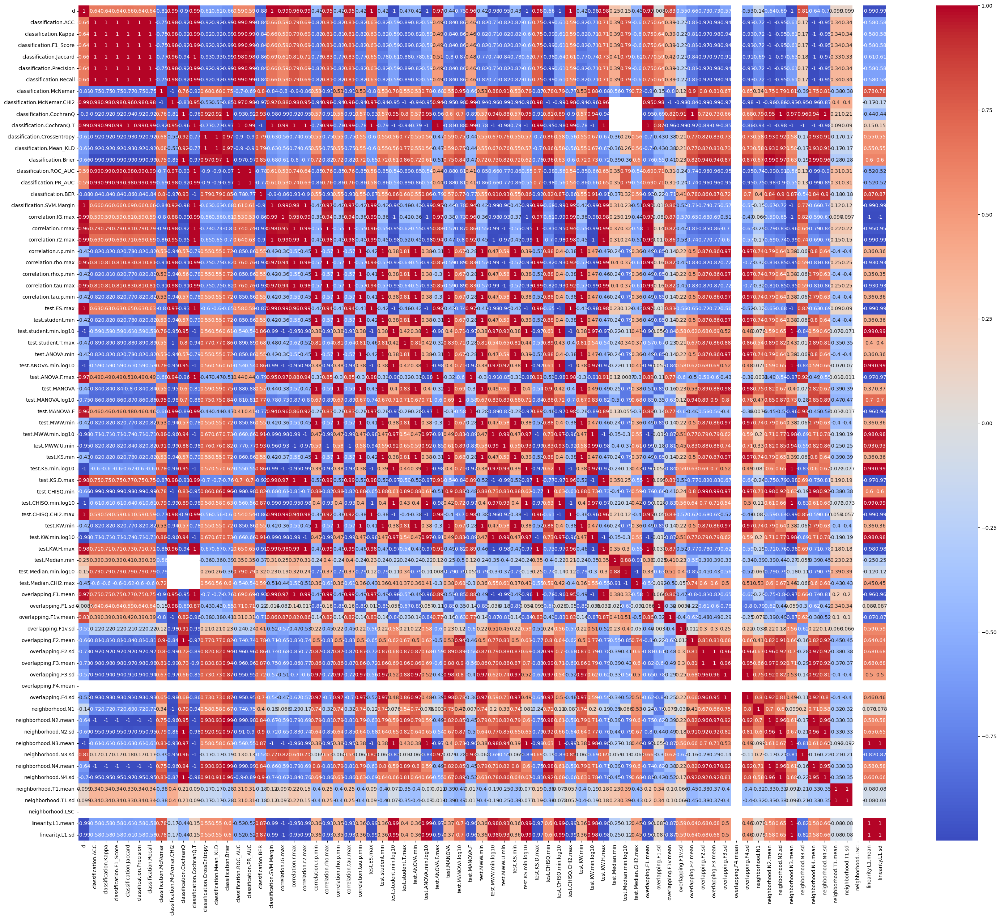

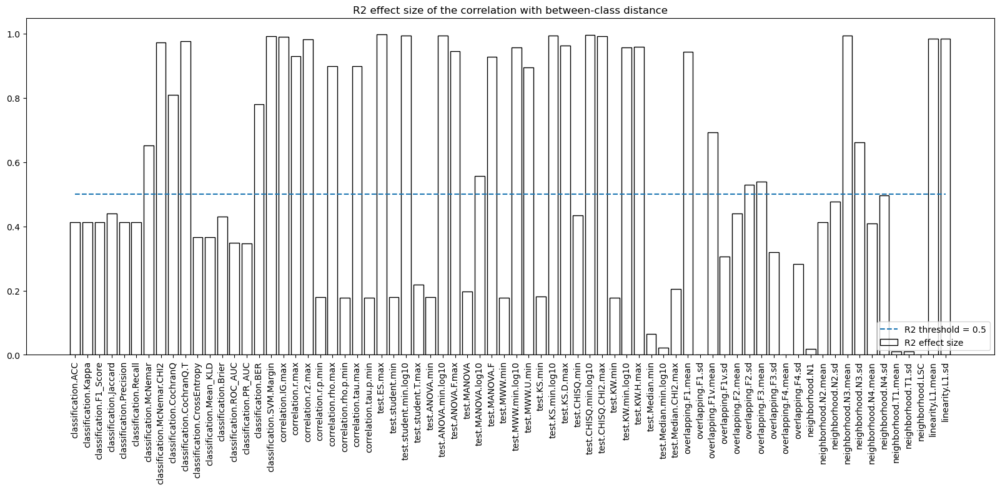

Metrics above the threshold (0.5):  ['classification.McNemar' 'classification.McNemar.CHI2'
 'classification.CochranQ' 'classification.CochranQ.T'
 'classification.BER' 'classification.SVM.Margin' 'correlation.IG.max'
 'correlation.r.max' 'correlation.r2.max' 'correlation.rho.max'
 'correlation.tau.max' 'test.ES.max' 'test.student.min.log10'
 'test.ANOVA.min.log10' 'test.ANOVA.F.max' 'test.MANOVA.log10'
 'test.MANOVA.F' 'test.MWW.min.log10' 'test.MWW.U.min' 'test.KS.min.log10'
 'test.KS.D.max' 'test.CHISQ.min.log10' 'test.CHISQ.CHI2.max'
 'test.KW.min.log10' 'test.KW.H.max' 'overlapping.F1.mean'
 'overlapping.F1v.mean' 'overlapping.F2.sd' 'overlapping.F3.mean'
 'neighborhood.N3.mean' 'neighborhood.N3.sd' 'linearity.L1.mean'
 'linearity.L1.sd']

----- Atom metric synthesis method: meta.logistic -----
2023-08-27 00:15:09,654 - WARNING - R[write to console]: In addition: 
2023-08-27 00:15:09,654 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the fir

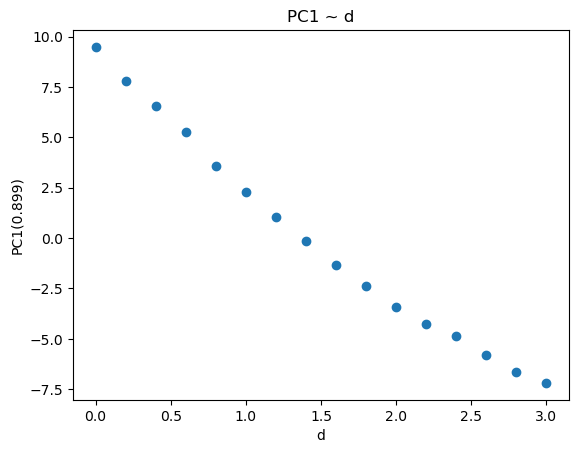

Explained Variance Ratios for the first three PCs [0.89906025 0.06997    0.01853558]


100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [31:41<00:00, 39.62s/it]


2023-08-27 00:21:15,533 - WARNING - R[write to console]: In addition: 
2023-08-27 00:21:15,533 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 00:21:15,533 - WARNING - R[write to console]: 

2023-08-27 00:22:03,784 - WARNING - R[write to console]: In addition: 
2023-08-27 00:22:03,784 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 00:22:03,784 - WARNING - R[write to console]: 

2023-08-27 00:22:52,900 - WARNING - R[write to console]: In addition: 
2023-08-27 00:22:52,900 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 00:22:52,900 - WARNING - R[write to console]: 

2023-08-27 00:23:41,528 - WARNING - R[write to console]: In addition: 
2023-08-27 00:23:41,528 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 00:23:41,528 - WARNING - R[w

{'GaussianNB()': [1.0], 'DecisionTreeClassifier(max_depth=2)': [1.0], 'RandomForestClassifier(n_estimators=2)': [0.972972972972973], "LinearSVC(C=0.01, multi_class='crammer_singer')": [1.0], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [1.0], 'MLPClassifier(alpha=1, hidden_layer_sizes=(11,))': [0.5135135135135135], 'KNeighborsClassifier(n_neighbors=1)': [1.0], 'LinearDiscriminantAnalysis()': [1.0], 'ELMClassifier(n_hidden_nodes=50)': [1.0], 'RVFLClassifier(n_hidden_nodes=1)': [1.0]}


load dataset from 7545.csv
X.shape (120, 1000)  y.shape (120,)


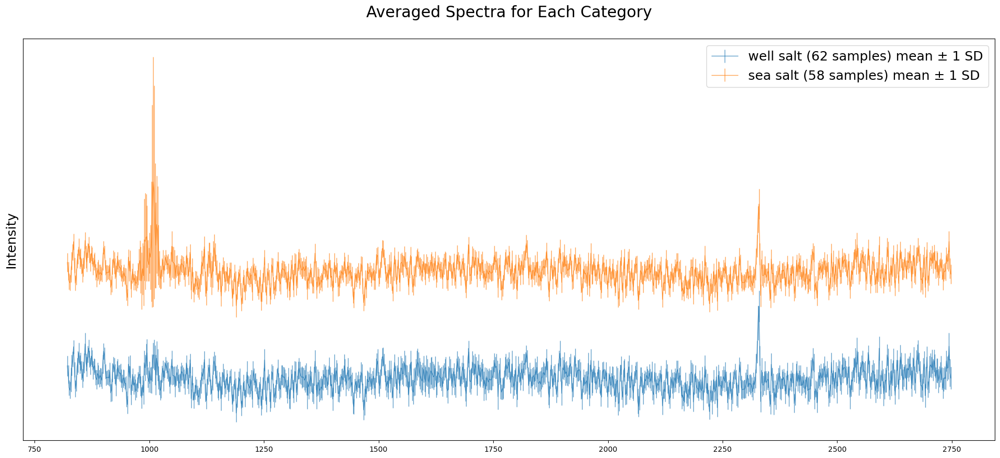

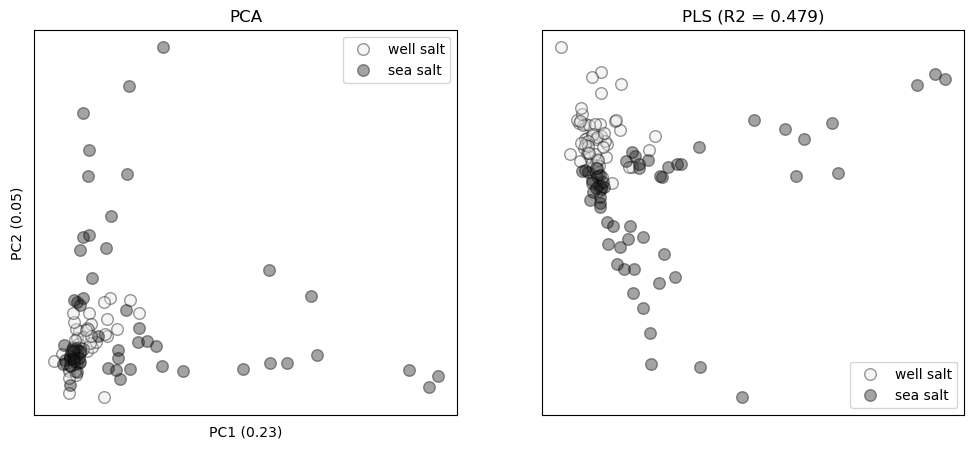

Raman spectra of table salt 食盐拉曼光谱

C1 - "shenjinkuangyan(zhongyan)：深井矿盐（中盐集团）加碘盐", 
“deep well mineral salt” from CNSIC (China National Salt Industry Co.,Ltd).

C2 - "aozhoutianranhaiyan(huaiyan)：澳洲天然海盐（淮盐）未加碘",
“Australian natural sea salt” from Suyan Group.

Instrument: Thermo Fisher DXR2xi
DXR2xi显微拉曼成像光谱仪（美国Thermo Fisher公司），
配备有532 nm激光器。
仪器参数设置：
激光功率为10 mw，曝光时间1 s，扫描次数500，
拉曼位移范围为100～3000 cm-1。

--------------------
If you use this data set, please add the reference: 
[1] Analytical chemistry kernel library for spectroscopic profiling data, Food Chemistry Advances, Volume 3, 2023, 100342, ISSN 2772-753X, https://doi.org/10.1016/j.focha.2023.100342


窗函数预处理（max）: binning window width =  1 / 0.1 = 10


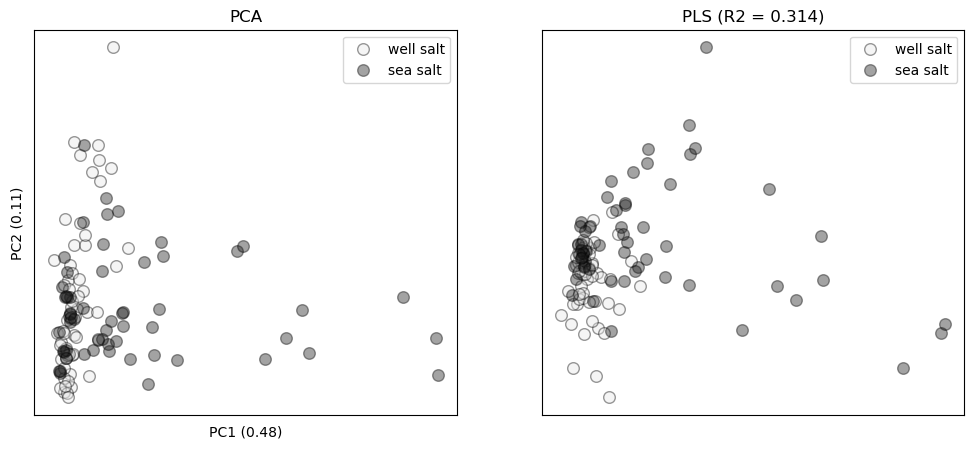

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [35:31<00:00, 42.48s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.521,0.743,0.944,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,0.042,0.486,0.889,0.986,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.521,0.743,0.944,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.352,0.593,0.895,0.986,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.521,0.743,0.944,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.521,0.743,0.944,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.782,0.581,0.576,0.333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,0.087,0.372,0.611,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.738,0.405,0.268,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,0.186,0.778,1.778,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827010238.314937.pkl


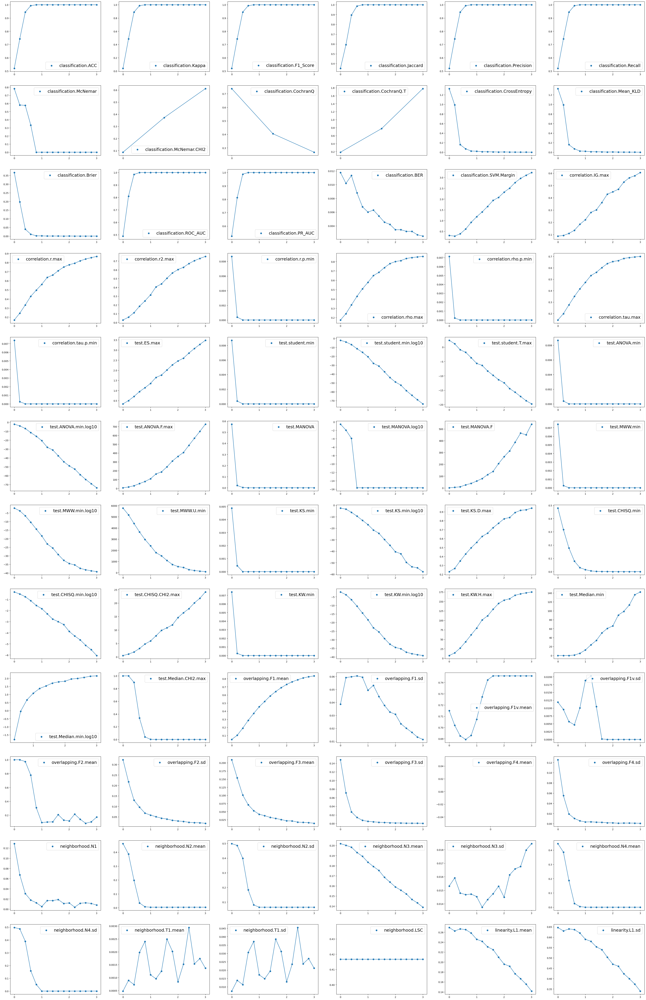

before filter


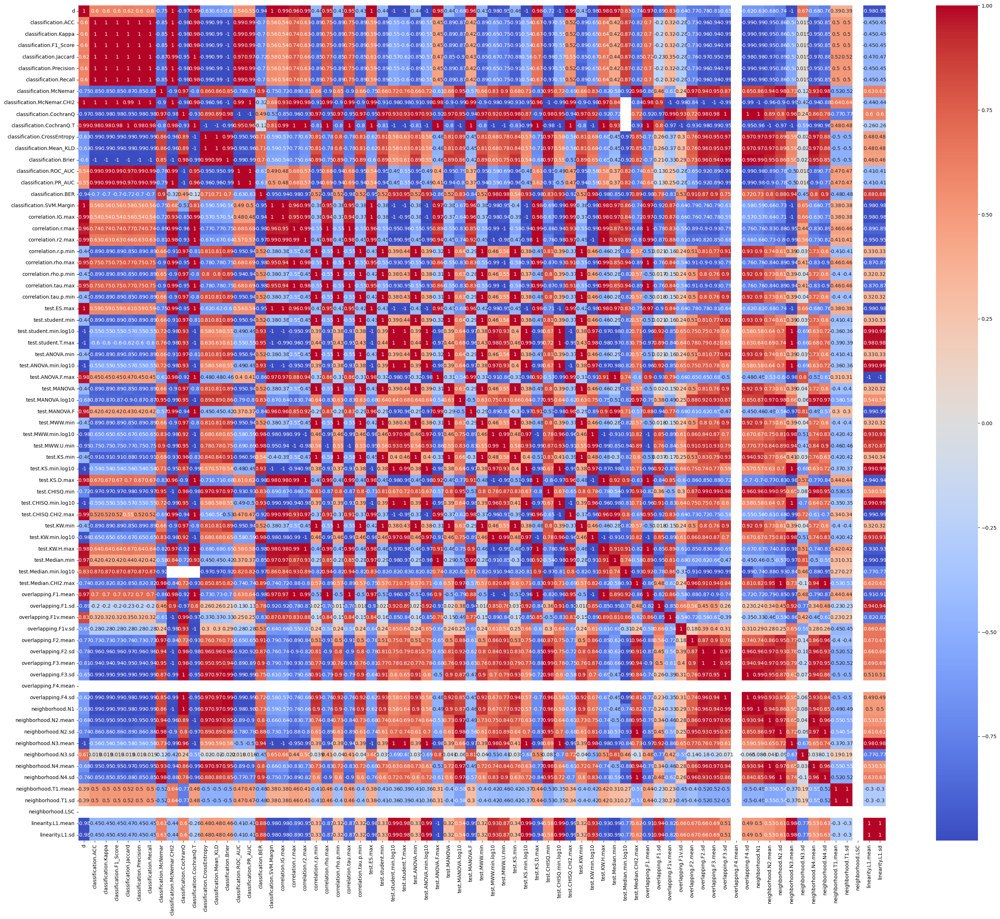

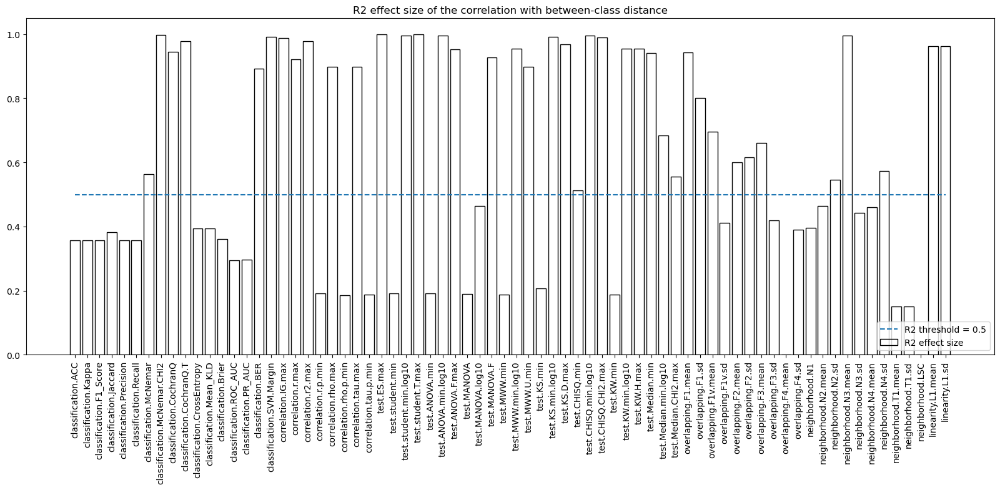

Metrics above the threshold (0.5):  ['classification.McNemar' 'classification.McNemar.CHI2'
 'classification.CochranQ' 'classification.CochranQ.T'
 'classification.BER' 'classification.SVM.Margin' 'correlation.IG.max'
 'correlation.r.max' 'correlation.r2.max' 'correlation.rho.max'
 'correlation.tau.max' 'test.ES.max' 'test.student.min.log10'
 'test.student.T.max' 'test.ANOVA.min.log10' 'test.ANOVA.F.max'
 'test.MANOVA.F' 'test.MWW.min.log10' 'test.MWW.U.min' 'test.KS.min.log10'
 'test.KS.D.max' 'test.CHISQ.min' 'test.CHISQ.min.log10'
 'test.CHISQ.CHI2.max' 'test.KW.min.log10' 'test.KW.H.max'
 'test.Median.min' 'test.Median.min.log10' 'test.Median.CHI2.max'
 'overlapping.F1.mean' 'overlapping.F1.sd' 'overlapping.F1v.mean'
 'overlapping.F2.mean' 'overlapping.F2.sd' 'overlapping.F3.mean'
 'neighborhood.N2.sd' 'neighborhood.N3.mean' 'neighborhood.N4.sd'
 'linearity.L1.mean' 'linearity.L1.sd']

----- Atom metric synthesis method: meta.logistic -----
2023-08-27 01:05:19,808 - WARNING - R[wri

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [38:47<00:00, 48.49s/it]


2023-08-27 01:06:25,079 - WARNING - R[write to console]: In addition: 
2023-08-27 01:06:25,094 - WARNING - R[write to console]: Warning message:

2023-08-27 01:06:25,094 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 01:06:25,094 - WARNING - R[write to console]: 
 
2023-08-27 01:06:25,094 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

2023-08-27 01:06:52,263 - WARNING - R[write to console]: In addition: 
2023-08-27 01:06:52,263 - WARNING - R[write to console]: Warning message:

2023-08-27 01:06:52,263 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 01:06:52,279 - WARNING - R[write to console]: 
 
2023-08-27 01:06:52,279 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

2023-08-27 01:07:19,149 - WARNING - R[write to console]: In addition: 
2023-08-27 

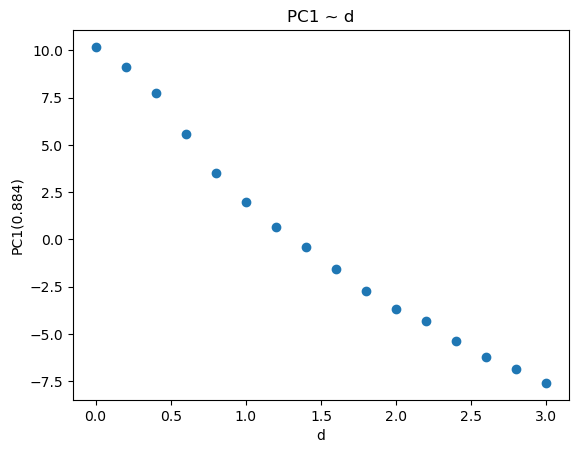

Explained Variance Ratios for the first three PCs [0.8844263  0.09253422 0.01333447]
2023-08-27 01:08:47,808 - WARNING - R[write to console]: In addition: 
2023-08-27 01:08:47,808 - WARNING - R[write to console]: Warning message:

2023-08-27 01:08:47,808 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 01:08:47,808 - WARNING - R[write to console]: 
 
2023-08-27 01:08:47,823 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

2023-08-27 01:09:14,458 - WARNING - R[write to console]: In addition: 
2023-08-27 01:09:14,458 - WARNING - R[write to console]: Warning message:

2023-08-27 01:09:14,458 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 01:09:14,458 - WARNING - R[write to console]: 
 
2023-08-27 01:09:14,458 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful case

{'GaussianNB()': [0.6944444444444444], 'DecisionTreeClassifier(max_depth=1)': [0.6666666666666666], 'RandomForestClassifier(n_estimators=3)': [0.6111111111111112], "LinearSVC(C=0.01, multi_class='crammer_singer')": [0.5833333333333334], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [0.6666666666666666], 'MLPClassifier(hidden_layer_sizes=(81,))': [0.6944444444444444], 'KNeighborsClassifier(n_neighbors=1)': [0.7777777777777778], 'LinearDiscriminantAnalysis()': [0.6111111111111112], 'ELMClassifier(n_hidden_nodes=10)': [0.6388888888888888], 'RVFLClassifier(n_hidden_nodes=1)': [0.5]}


load dataset from ovarian-cancer-nci-pbsii-data.csv
X.shape (253, 9000)  y.shape (253,)
OvarianCancer-NCI-PBSII-061902

Emanuel F Petricoin III, et al. "Use of Proteomic Patterns in Serum to Identify Ovarian Cancer". The Lancet, 359:572-577, February, 2002

Generated by surface-enhanced laser desorption and ionisation mass spectroscopy. SELDI—a refinement of MALDI—preselects the proteins in the sample by allowing them to bind to the treated surface of a metal bar, which is coated with a specific chemical that binds a subset of the proteins within the serum sample

The goal of this experiment is to identify proteomic patterns in serum that distinguish ovarian cancer from non-cancer. This study is significant to women who have a high risk of ovarian cancer due to family or personal history of cancer. The proteomic spectra were generated by mass spectroscopy and the data set provided here is 6-19-02, which includes 91 controls (Normal) and 162 ovarian cancers. The raw spectral data of eac

窗函数预处理（max）: binning window width =  1 / 0.01 = 100


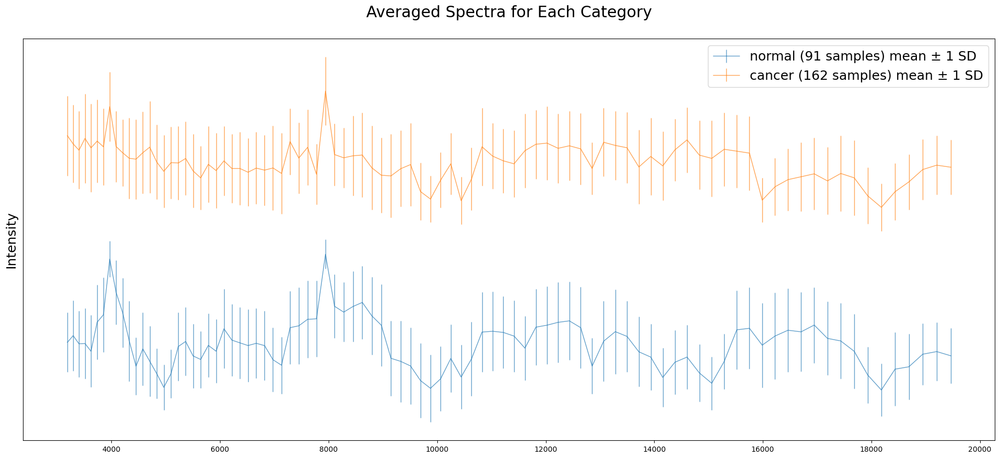

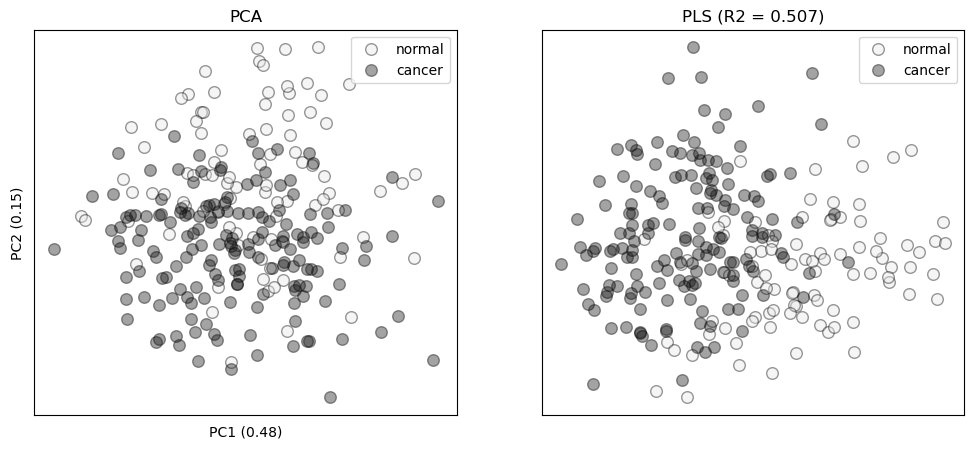

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [49:54<00:00, 62.19s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.52,0.82,0.977,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,0.039,0.641,0.954,0.993,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.52,0.82,0.977,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.351,0.696,0.955,0.994,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.52,0.82,0.977,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.52,0.82,0.977,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.405,0.751,0.402,0.333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,7.287,0.122,0.778,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.345,0.583,0.414,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,7.847,0.333,1.667,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827020126.286136.pkl


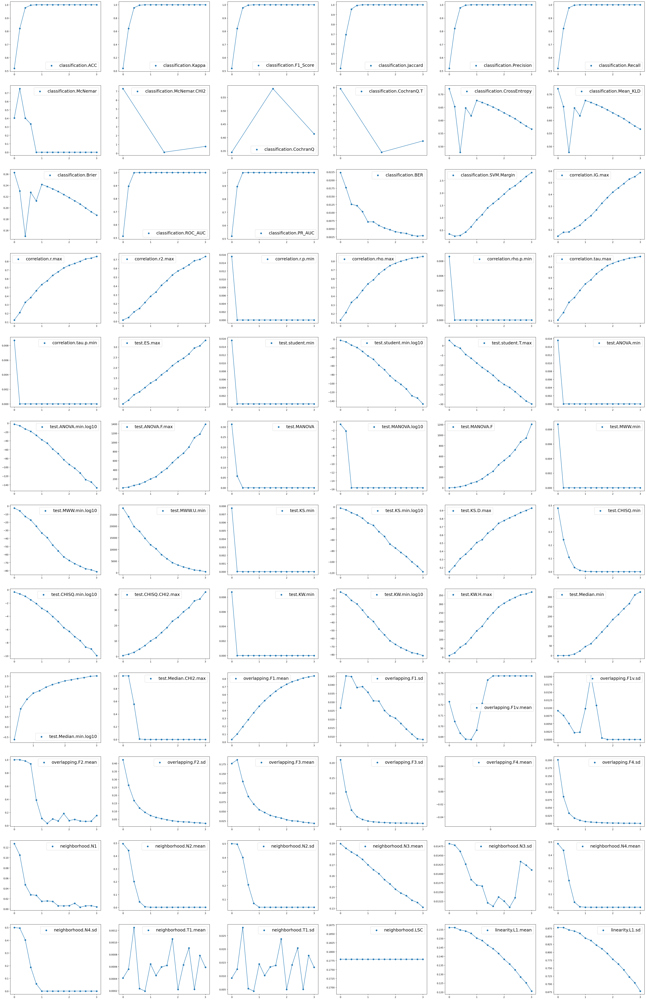

before filter


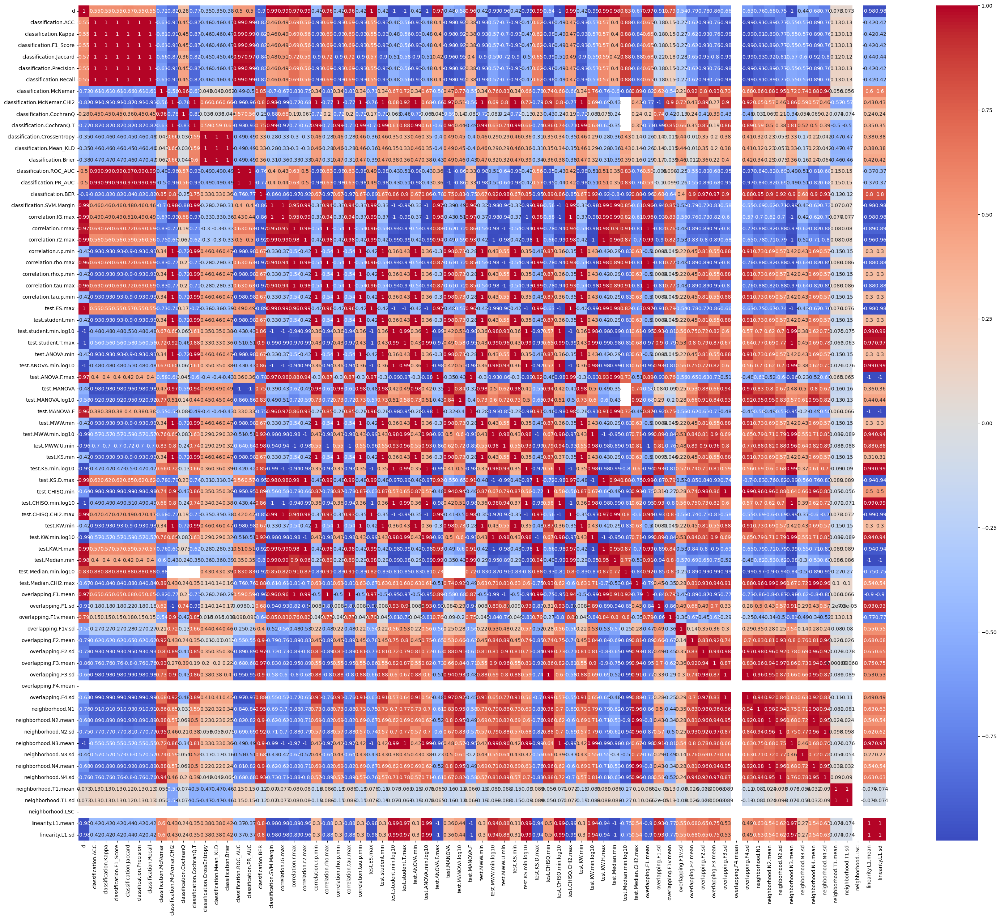

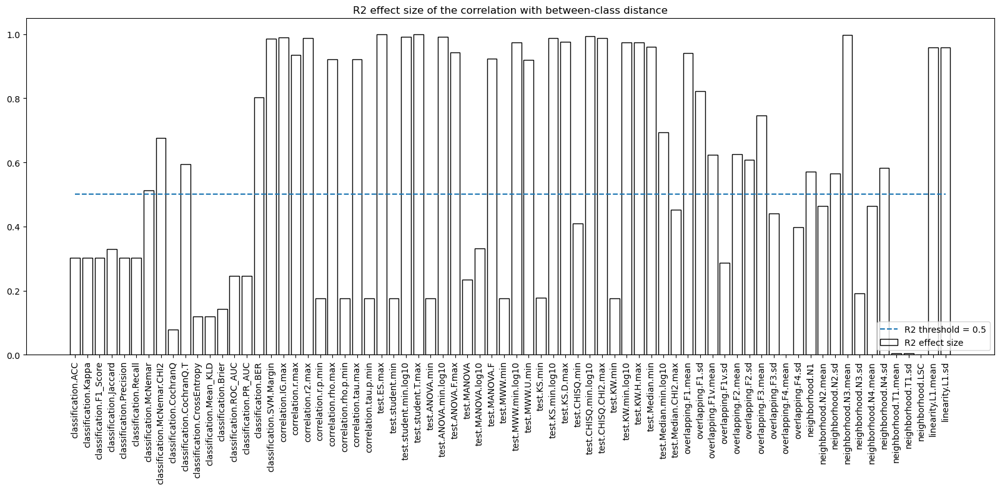

Metrics above the threshold (0.5):  ['classification.McNemar' 'classification.McNemar.CHI2'
 'classification.CochranQ.T' 'classification.BER'
 'classification.SVM.Margin' 'correlation.IG.max' 'correlation.r.max'
 'correlation.r2.max' 'correlation.rho.max' 'correlation.tau.max'
 'test.ES.max' 'test.student.min.log10' 'test.student.T.max'
 'test.ANOVA.min.log10' 'test.ANOVA.F.max' 'test.MANOVA.F'
 'test.MWW.min.log10' 'test.MWW.U.min' 'test.KS.min.log10' 'test.KS.D.max'
 'test.CHISQ.min.log10' 'test.CHISQ.CHI2.max' 'test.KW.min.log10'
 'test.KW.H.max' 'test.Median.min' 'test.Median.min.log10'
 'overlapping.F1.mean' 'overlapping.F1.sd' 'overlapping.F1v.mean'
 'overlapping.F2.mean' 'overlapping.F2.sd' 'overlapping.F3.mean'
 'neighborhood.N1' 'neighborhood.N2.sd' 'neighborhood.N3.mean'
 'neighborhood.N4.sd' 'linearity.L1.mean' 'linearity.L1.sd']

----- Atom metric synthesis method: meta.logistic -----


100%|███████████████████████████████████████████████████████████████████████████████| 48/48 [8:59:22<00:00, 674.21s/it]


----- End of meta.logistic -----


----- Atom metric synthesis method: decompose.pca -----


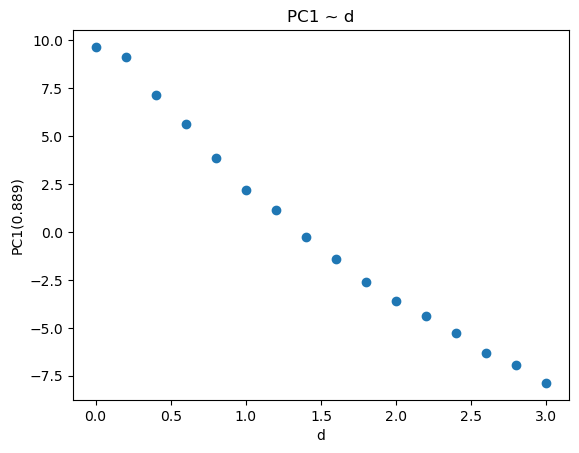

Explained Variance Ratios for the first three PCs [0.88917996 0.0808963  0.01615798]
PC1 before mapping:  2.8794385912612768 [5.003145279803325, 5.67188706092152]
----- End of decompose.pca -----

between-class and in-class scores:
{'meta.logistic': {'umetric_bw': 0.7487666822063684, 'umetric_in': [0.345495820807224, 0.8819749270083855]}, 'decompose.pca': {'umetric_bw': 0.8505260452689486, 'umetric_in': array([0.59213346, 0.52563961])}}



{'GaussianNB()': [0.8157894736842105], 'DecisionTreeClassifier(max_depth=1)': [0.7631578947368421], 'RandomForestClassifier(n_estimators=9)': [0.8421052631578947], "LinearSVC(C=10, multi_class='crammer_singer')": [0.9736842105263158], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [0.9342105263157895], 'MLPClassifier(hidden_layer_sizes=(81,))': [0.9473684210526315], 'KNeighborsClassifier(n_neighbors=4)': [0.881578947368421], 'LinearDiscriminantAnalysis()': [0.9473684210526315], 'ELMClassifier(n_hidden_nodes=50)': [0.8421052631578947], 'RVFLClassifier(n_hidden_nodes=2)': [0.9736842105263158]}


X.shape (309, 400)  y.shape (309,)
Raman spectra of serum from confirmed COVID-19 patients and healthy individuals.


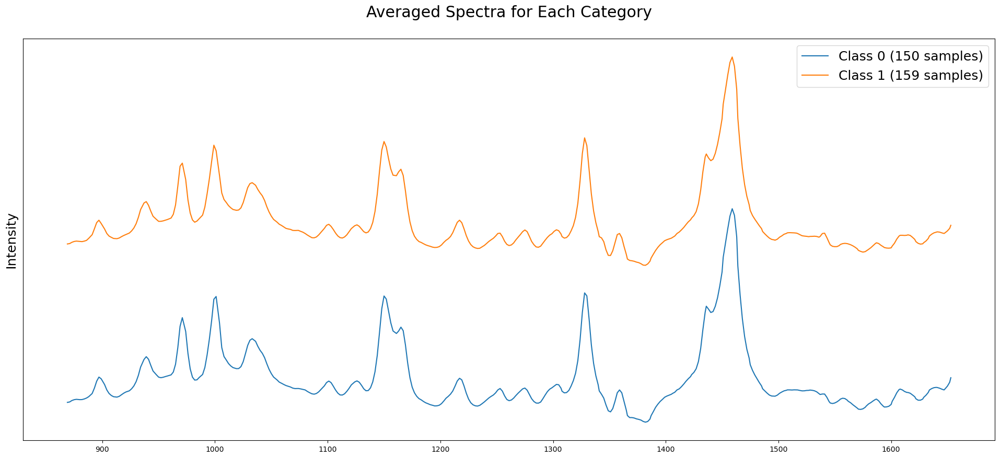

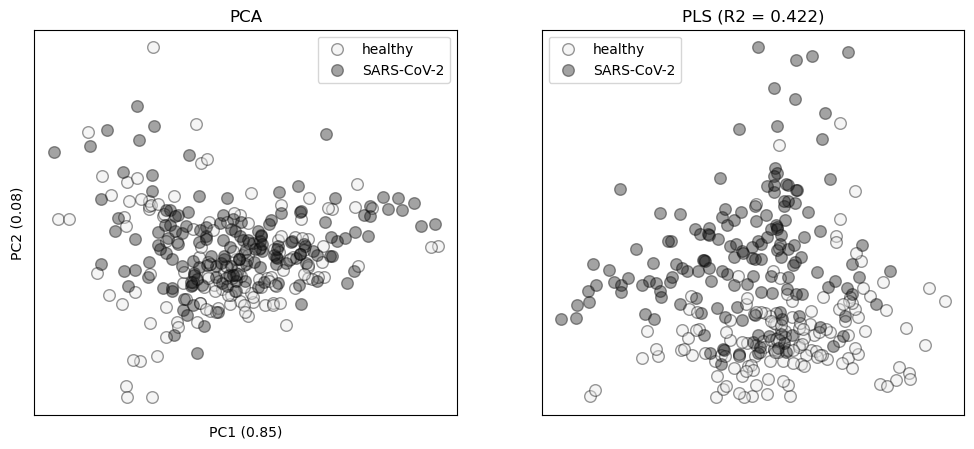

100%|████████████████████████████████████████████████████████████████████████████████| 48/48 [1:30:49<00:00, 73.26s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.508,0.903,0.989,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,0.016,0.806,0.978,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.508,0.903,0.989,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.341,0.825,0.979,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.508,0.903,0.989,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.508,0.903,0.989,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.264,0.482,0.667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,29.659,1.147,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.23,0.341,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,30.803,1.727,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827114317.725131.pkl


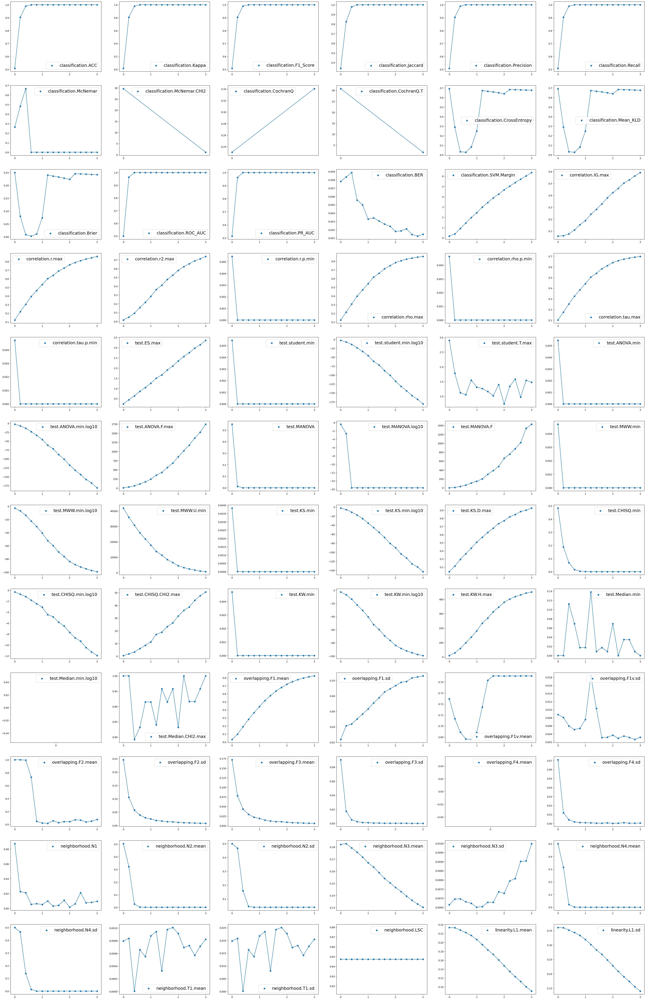

before filter


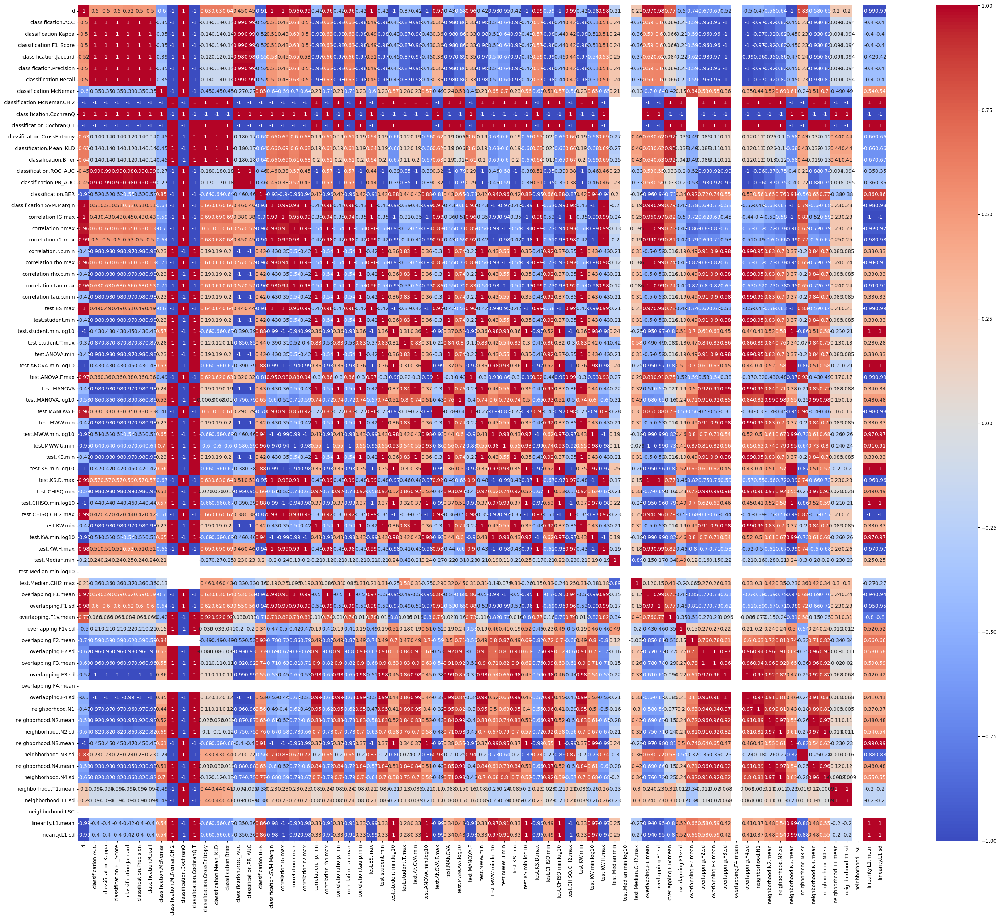

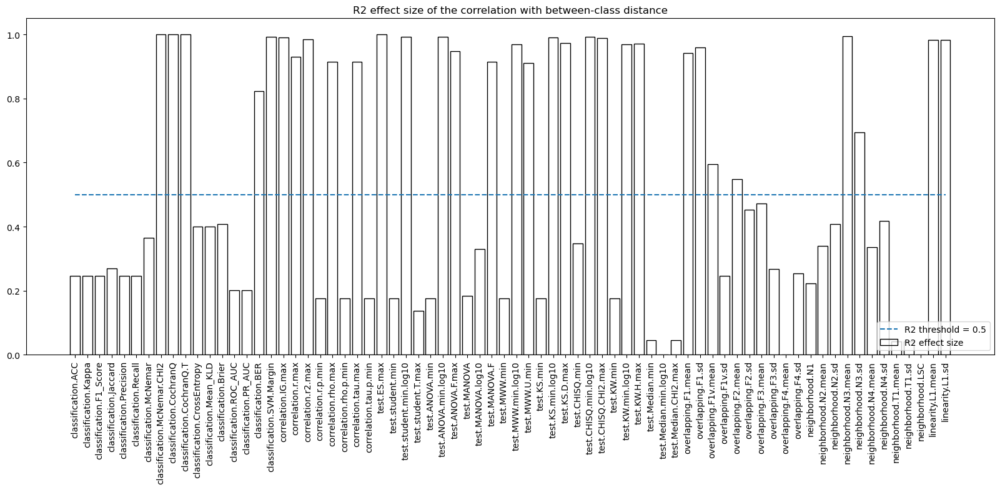

Metrics above the threshold (0.5):  ['classification.McNemar.CHI2' 'classification.CochranQ'
 'classification.CochranQ.T' 'classification.BER'
 'classification.SVM.Margin' 'correlation.IG.max' 'correlation.r.max'
 'correlation.r2.max' 'correlation.rho.max' 'correlation.tau.max'
 'test.ES.max' 'test.student.min.log10' 'test.ANOVA.min.log10'
 'test.ANOVA.F.max' 'test.MANOVA.F' 'test.MWW.min.log10' 'test.MWW.U.min'
 'test.KS.min.log10' 'test.KS.D.max' 'test.CHISQ.min.log10'
 'test.CHISQ.CHI2.max' 'test.KW.min.log10' 'test.KW.H.max'
 'overlapping.F1.mean' 'overlapping.F1.sd' 'overlapping.F1v.mean'
 'overlapping.F2.mean' 'neighborhood.N3.mean' 'neighborhood.N3.sd'
 'linearity.L1.mean' 'linearity.L1.sd']

----- Atom metric synthesis method: meta.logistic -----


100%|███████████████████████████████████████████████████████████████████████████████| 48/48 [1:31:19<00:00, 114.16s/it]


2023-08-27 11:44:43,041 - WARNING - R[write to console]: In addition: 
2023-08-27 11:44:43,041 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:44:43,041 - WARNING - R[write to console]: 

2023-08-27 11:45:15,608 - WARNING - R[write to console]: In addition: 
2023-08-27 11:45:15,608 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:45:15,608 - WARNING - R[write to console]: 

2023-08-27 11:45:47,610 - WARNING - R[write to console]: In addition: 
2023-08-27 11:45:47,626 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:45:47,626 - WARNING - R[write to console]: 

2023-08-27 11:46:20,054 - WARNING - R[write to console]: In addition: 
2023-08-27 11:46:20,054 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:46:20,054 - WARNING - R[w

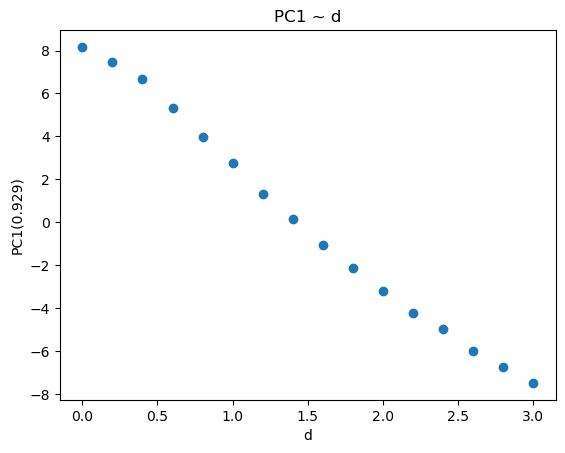

Explained Variance Ratios for the first three PCs [0.92911485 0.04920496 0.01518259]
2023-08-27 11:48:49,048 - WARNING - R[write to console]: In addition: 
2023-08-27 11:48:49,048 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:48:49,048 - WARNING - R[write to console]: 

2023-08-27 11:49:22,169 - WARNING - R[write to console]: In addition: 
2023-08-27 11:49:22,169 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:49:22,169 - WARNING - R[write to console]: 

2023-08-27 11:49:54,842 - WARNING - R[write to console]: In addition: 
2023-08-27 11:49:54,842 - WARNING - R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
2023-08-27 11:49:54,842 - WARNING - R[write to console]: 

2023-08-27 11:50:27,091 - WARNING - R[write to console]: In addition: 
2023-08-27 11:50:27,106 - WARNING - R[write to console]: There were 50 or more 

{'GaussianNB()': [0.8064516129032258], 'DecisionTreeClassifier(max_depth=3)': [0.7526881720430108], 'RandomForestClassifier(n_estimators=8)': [0.8817204301075269], "LinearSVC(C=10, multi_class='crammer_singer')": [0.8279569892473119], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [0.9354838709677419], 'MLPClassifier(hidden_layer_sizes=(101,))': [0.8064516129032258], 'KNeighborsClassifier(n_neighbors=1)': [0.8387096774193549], 'LinearDiscriminantAnalysis()': [0.8817204301075269], 'ELMClassifier(n_hidden_nodes=75)': [0.9247311827956989], 'RVFLClassifier(n_hidden_nodes=5)': [0.8279569892473119]}


X.shape (80, 2800)  y.shape (80,)
Raman spectra of healthy and diabetes II patients. Device is a portable Raman spectrometer (PEK-785, Agiltron Inc.) with a 785 nm, 90 mW laser beam, focused to a spot size of 200 µm. 


消除基线飘移: baseline removal (regularization = 100000000.0, residual penalty asymetry = 0.001)


窗函数预处理（max）: binning window width =  1 / 0.1 = 10


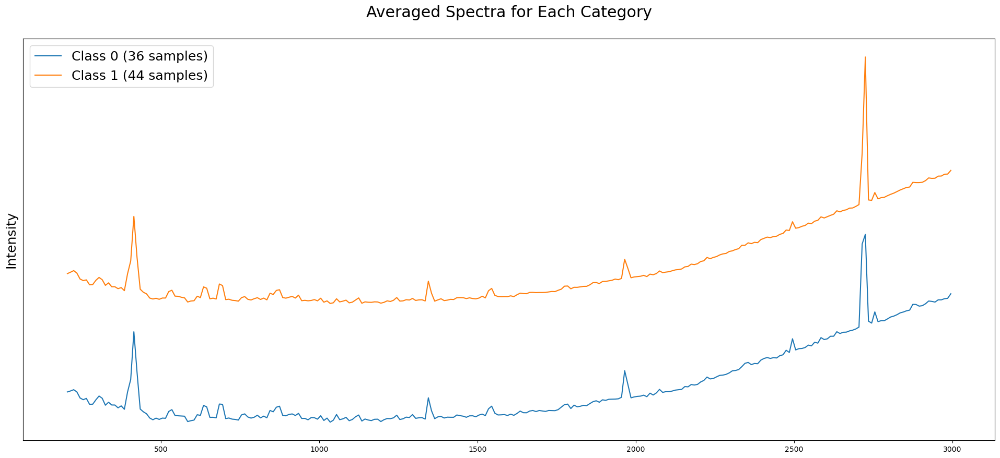

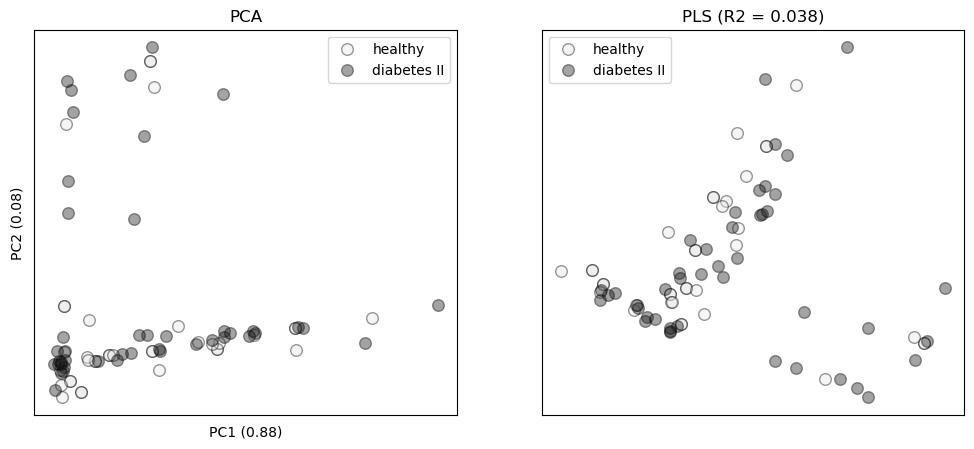

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [16:49<00:00, 20.61s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.531,0.708,0.917,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,0.062,0.417,0.833,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.531,0.708,0.917,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.362,0.556,0.846,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.531,0.708,0.917,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.531,0.708,0.917,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.767,0.436,0.827,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,0.356,1.491,0.167,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.596,0.28,0.709,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,0.6,2.268,0.222,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827120923.780647.pkl


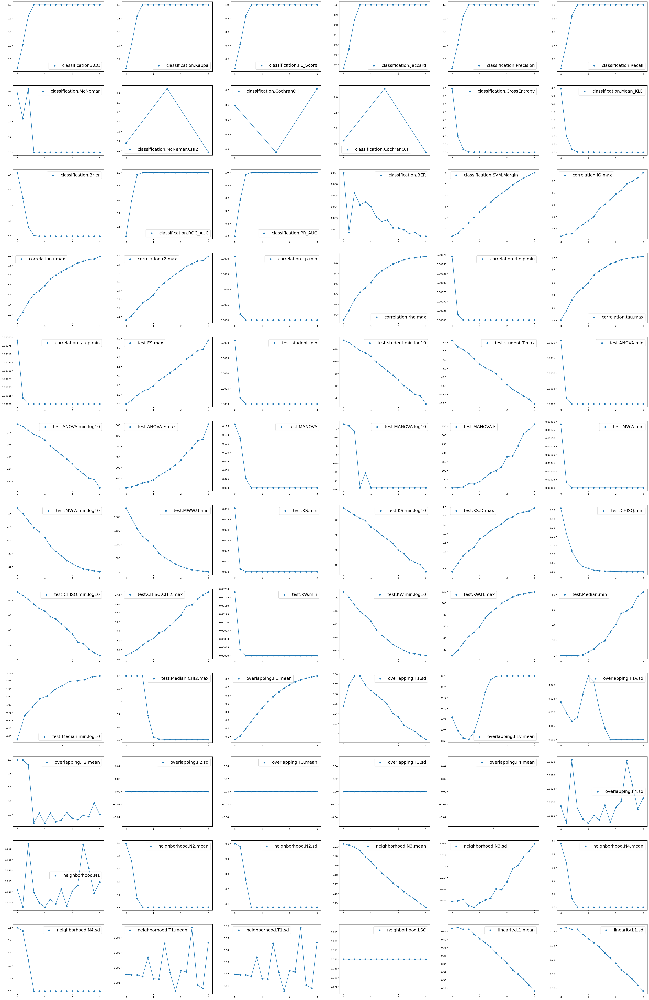

before filter


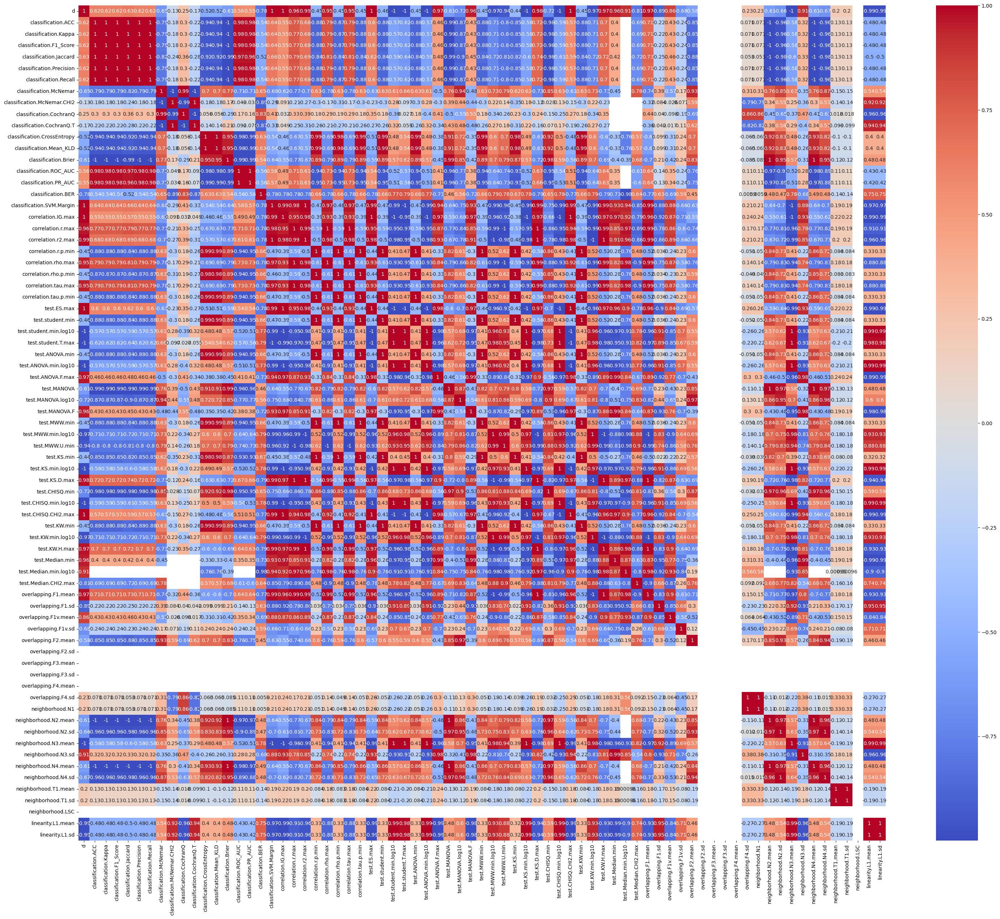

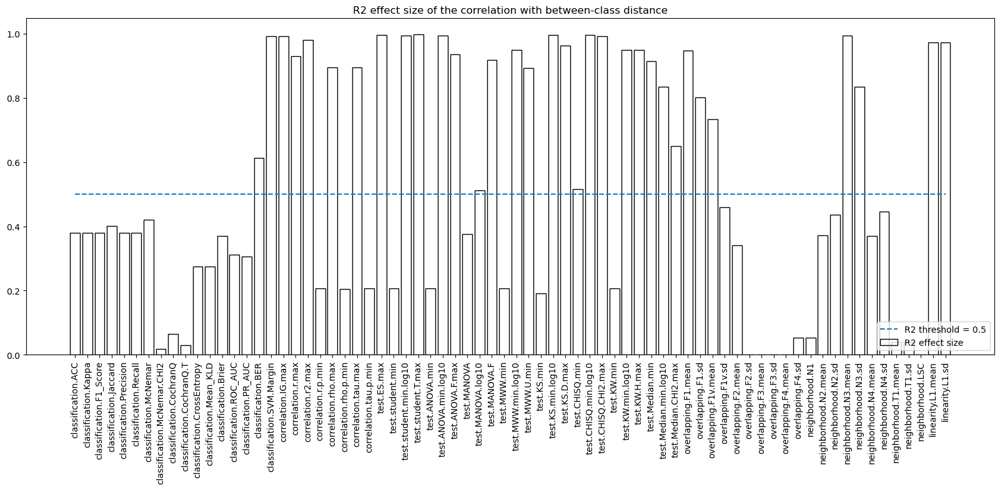

Metrics above the threshold (0.5):  ['classification.BER' 'classification.SVM.Margin' 'correlation.IG.max'
 'correlation.r.max' 'correlation.r2.max' 'correlation.rho.max'
 'correlation.tau.max' 'test.ES.max' 'test.student.min.log10'
 'test.student.T.max' 'test.ANOVA.min.log10' 'test.ANOVA.F.max'
 'test.MANOVA.log10' 'test.MANOVA.F' 'test.MWW.min.log10' 'test.MWW.U.min'
 'test.KS.min.log10' 'test.KS.D.max' 'test.CHISQ.min'
 'test.CHISQ.min.log10' 'test.CHISQ.CHI2.max' 'test.KW.min.log10'
 'test.KW.H.max' 'test.Median.min' 'test.Median.min.log10'
 'test.Median.CHI2.max' 'overlapping.F1.mean' 'overlapping.F1.sd'
 'overlapping.F1v.mean' 'neighborhood.N3.mean' 'neighborhood.N3.sd'
 'linearity.L1.mean' 'linearity.L1.sd']

----- Atom metric synthesis method: meta.logistic -----
2023-08-27 12:10:06,006 - WARNING - R[write to console]: In addition: 
2023-08-27 12:10:06,006 - WARNING - R[write to console]: Warning message:

2023-08-27 12:10:06,006 - WARNING - R[write to console]: In stats::predi

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [17:51<00:00, 22.31s/it]


2023-08-27 12:10:44,941 - WARNING - R[write to console]: In addition: 
2023-08-27 12:10:44,941 - WARNING - R[write to console]: Warning message:

2023-08-27 12:10:44,941 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 12:10:44,941 - WARNING - R[write to console]: 
 
2023-08-27 12:10:44,941 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

2023-08-27 12:10:59,178 - WARNING - R[write to console]: In addition: 
2023-08-27 12:10:59,178 - WARNING - R[write to console]: Warning message:

2023-08-27 12:10:59,178 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 12:10:59,178 - WARNING - R[write to console]: 
 
2023-08-27 12:10:59,178 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

2023-08-27 12:11:15,093 - WARNING - R[write to console]: In addition: 
2023-08-27 

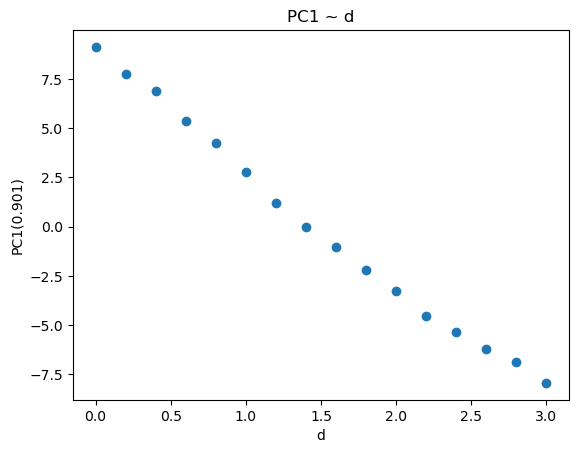

Explained Variance Ratios for the first three PCs [0.90129659 0.06366816 0.01529863]
2023-08-27 12:12:13,984 - WARNING - R[write to console]: In addition: 
2023-08-27 12:12:13,984 - WARNING - R[write to console]: Warning message:

2023-08-27 12:12:13,984 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 12:12:13,984 - WARNING - R[write to console]: 
 
2023-08-27 12:12:13,984 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

2023-08-27 12:12:30,119 - WARNING - R[write to console]: In addition: 
2023-08-27 12:12:30,119 - WARNING - R[write to console]: Warning message:

2023-08-27 12:12:30,119 - WARNING - R[write to console]: In stats::predict.lm(m, test[, -ncol(test), drop = FALSE]) :
2023-08-27 12:12:30,119 - WARNING - R[write to console]: 
 
2023-08-27 12:12:30,119 - WARNING - R[write to console]:  prediction from rank-deficient fit; attr(*, "non-estim") has doubtful case

{'GaussianNB()': [0.5833333333333334], 'DecisionTreeClassifier(max_depth=10)': [0.625], 'RandomForestClassifier(n_estimators=3)': [0.3333333333333333], "LinearSVC(C=0.01, multi_class='crammer_singer')": [0.8333333333333334], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [0.8333333333333334], 'MLPClassifier(alpha=0.01, hidden_layer_sizes=(101,))': [0.625], 'KNeighborsClassifier(n_neighbors=1)': [0.5], 'LinearDiscriminantAnalysis()': [0.8333333333333334], 'ELMClassifier()': [0.625], 'RVFLClassifier(n_hidden_nodes=1)': [0.7916666666666666]}


Raman spectroscopy of different colorectal cancer cell types
X.shape (330, 1300)  y.shape (330,)


窗函数预处理（max）: binning window width =  1 / 0.1 = 10


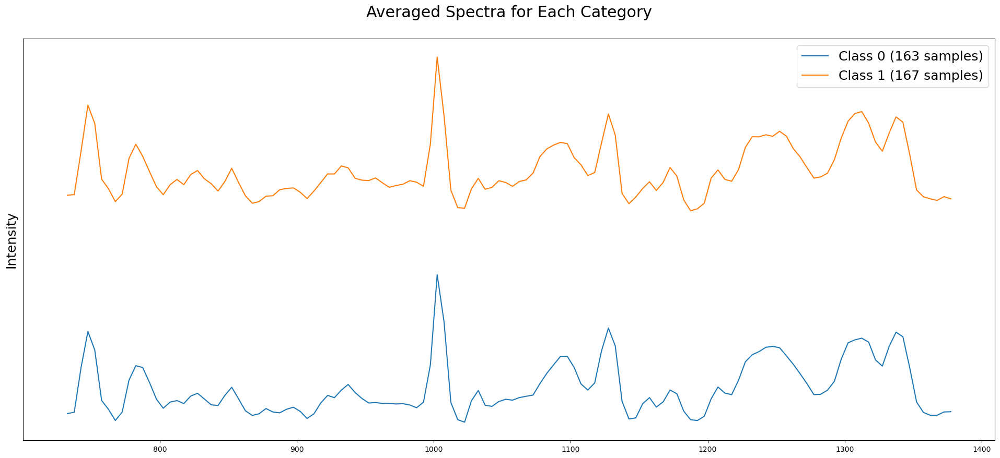

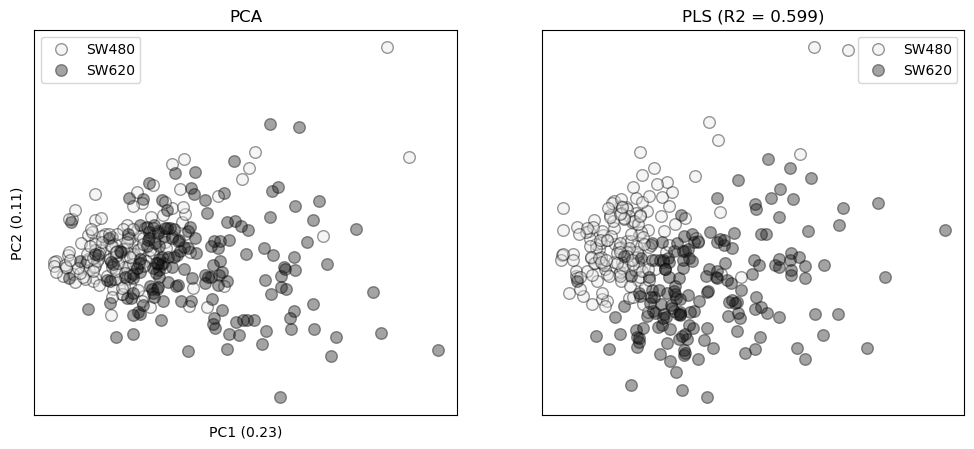

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [26:54<00:00, 79.31s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.472,0.823,0.985,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Kappa,-0.056,0.646,0.97,0.995,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.F1_Score,0.472,0.823,0.985,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Jaccard,0.31,0.7,0.97,0.995,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Precision,0.472,0.823,0.985,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.Recall,0.472,0.823,0.985,0.997,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
classification.McNemar,0.751,0.776,0.827,0.333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
classification.McNemar.CHI2,0.153,0.321,0.167,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.664,0.634,0.627,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,0.247,0.492,0.444,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827124111.095685.pkl


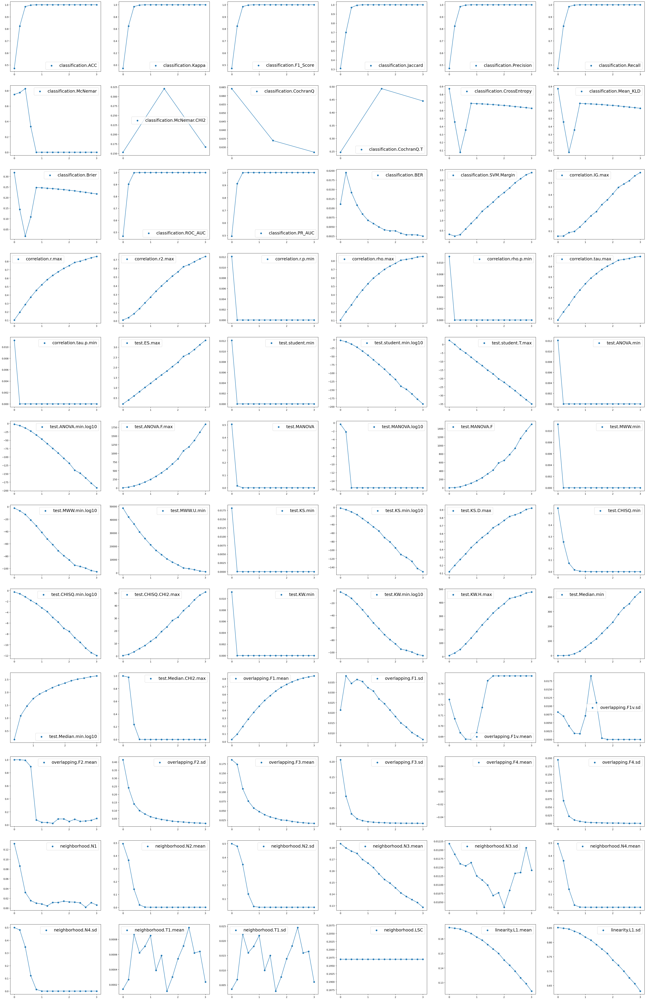

before filter


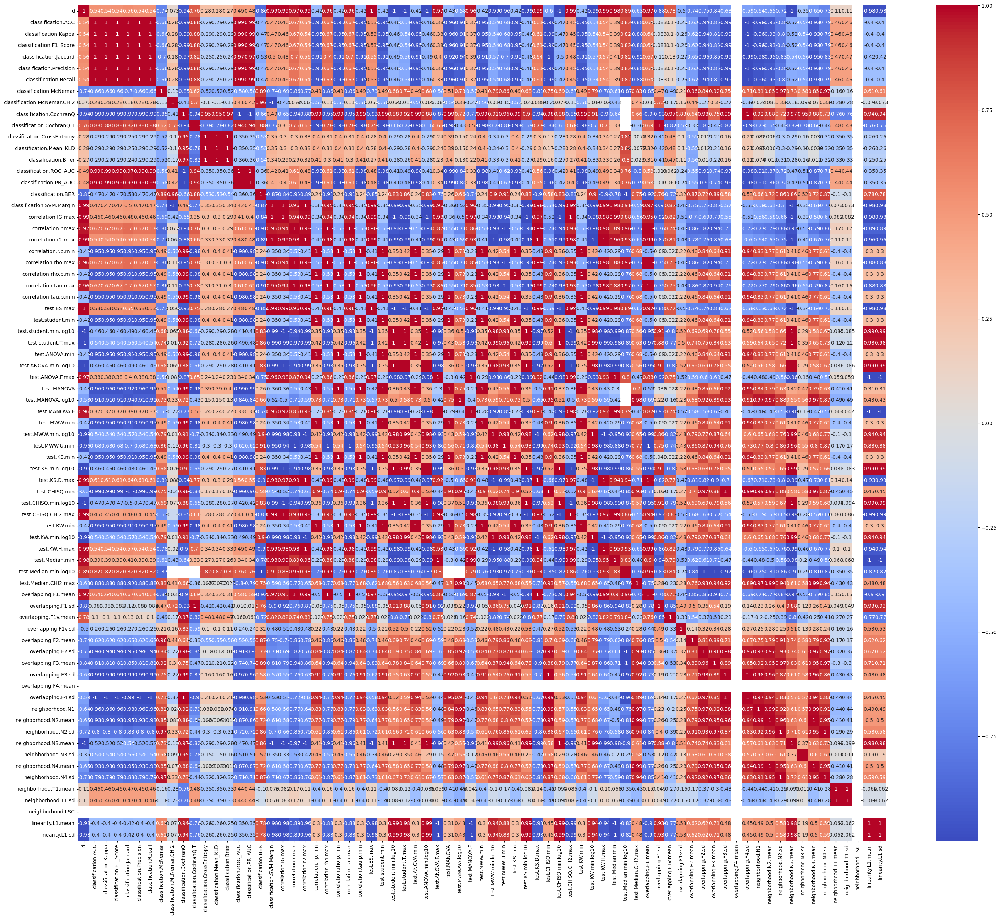

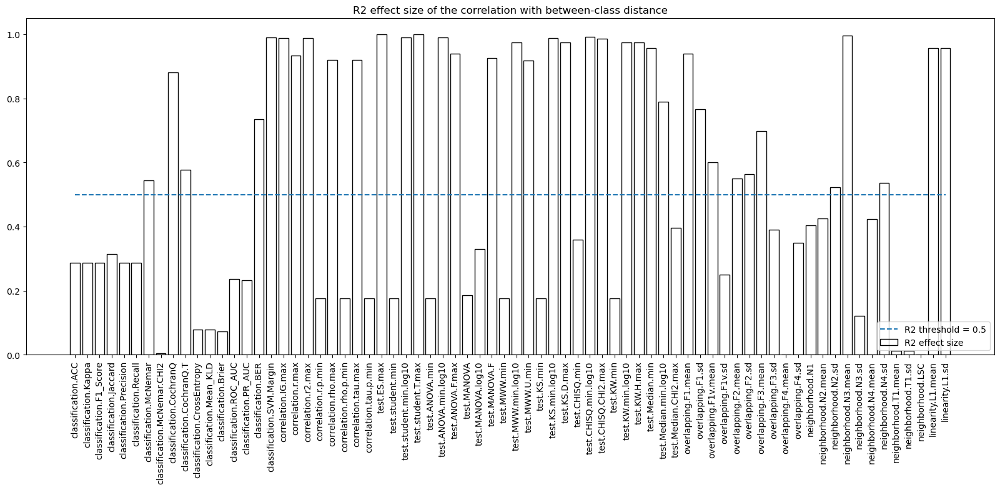

Metrics above the threshold (0.5):  ['classification.McNemar' 'classification.CochranQ'
 'classification.CochranQ.T' 'classification.BER'
 'classification.SVM.Margin' 'correlation.IG.max' 'correlation.r.max'
 'correlation.r2.max' 'correlation.rho.max' 'correlation.tau.max'
 'test.ES.max' 'test.student.min.log10' 'test.student.T.max'
 'test.ANOVA.min.log10' 'test.ANOVA.F.max' 'test.MANOVA.F'
 'test.MWW.min.log10' 'test.MWW.U.min' 'test.KS.min.log10' 'test.KS.D.max'
 'test.CHISQ.min.log10' 'test.CHISQ.CHI2.max' 'test.KW.min.log10'
 'test.KW.H.max' 'test.Median.min' 'test.Median.min.log10'
 'overlapping.F1.mean' 'overlapping.F1.sd' 'overlapping.F1v.mean'
 'overlapping.F2.mean' 'overlapping.F2.sd' 'overlapping.F3.mean'
 'neighborhood.N2.sd' 'neighborhood.N3.mean' 'neighborhood.N4.sd'
 'linearity.L1.mean' 'linearity.L1.sd']

----- Atom metric synthesis method: meta.logistic -----


100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [32:52<00:00, 41.10s/it]


----- End of meta.logistic -----


----- Atom metric synthesis method: decompose.pca -----


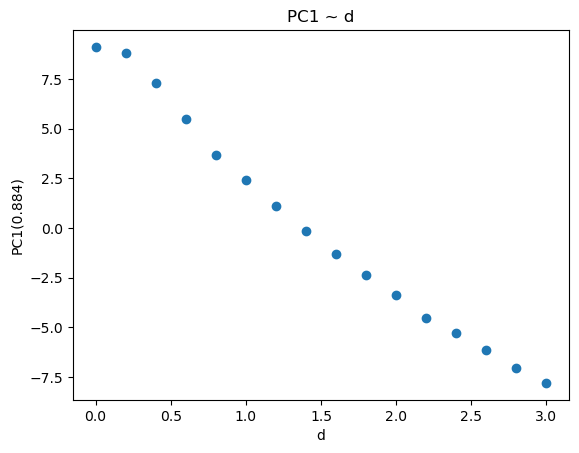

Explained Variance Ratios for the first three PCs [0.88393272 0.08562696 0.01652628]
PC1 before mapping:  6.675362246568629 [10.171707005400025, 10.175996933337828]
----- End of decompose.pca -----

between-class and in-class scores:
{'meta.logistic': {'umetric_bw': 1.2838652247711421e-05, 'umetric_in': [2.492687516276424e-07, 3.2942266143917754e-07]}, 'decompose.pca': {'umetric_bw': 0.4305980236052492, 'umetric_in': array([0.21607485, 0.21588738])}}



{'GaussianNB()': [0.8282828282828283], 'DecisionTreeClassifier(max_depth=4)': [0.6767676767676768], 'RandomForestClassifier(n_estimators=7)': [0.797979797979798], "LinearSVC(C=1, multi_class='crammer_singer')": [0.898989898989899], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [0.898989898989899], 'MLPClassifier(alpha=1, hidden_layer_sizes=(81,))': [0.9191919191919192], 'KNeighborsClassifier(n_neighbors=3)': [0.7171717171717171], 'LinearDiscriminantAnalysis()': [0.8787878787878788], 'ELMClassifier(n_hidden_nodes=50)': [0.7777777777777778], 'RVFLClassifier(n_hidden_nodes=10)': [0.8787878787878788]}


the well-known iris dataset


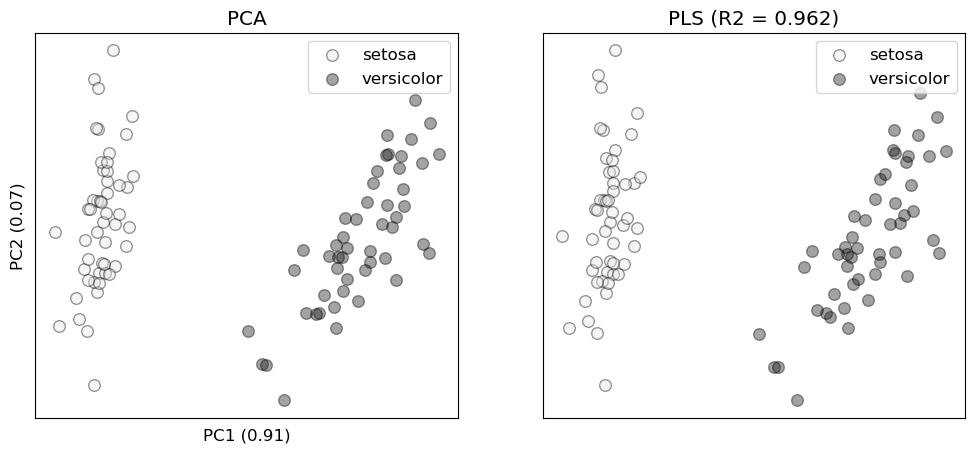

100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [08:00<00:00,  9.82s/it]

generate_html_for_dict()


d,0.0,0.2,0.4,0.6,0.8,1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0
classification.ACC,0.483,0.575,0.633,0.742,0.767,0.842,0.917,0.958,0.942,0.958,0.992,0.975,0.992,1.0,1.0,0.983
classification.Kappa,-0.033,0.15,0.267,0.483,0.533,0.683,0.833,0.917,0.883,0.917,0.983,0.95,0.983,1.0,1.0,0.967
classification.F1_Score,0.483,0.575,0.633,0.742,0.767,0.842,0.917,0.958,0.942,0.958,0.992,0.975,0.992,1.0,1.0,0.983
classification.Jaccard,0.322,0.409,0.466,0.593,0.623,0.727,0.848,0.92,0.891,0.92,0.984,0.952,0.984,1.0,1.0,0.967
classification.Precision,0.483,0.575,0.633,0.742,0.767,0.842,0.917,0.958,0.942,0.958,0.992,0.975,0.992,1.0,1.0,0.983
classification.Recall,0.483,0.575,0.633,0.742,0.767,0.842,0.917,0.958,0.942,0.958,0.992,0.975,0.992,1.0,1.0,0.983
classification.McNemar,0.82,0.57,0.793,0.559,0.65,0.789,0.827,0.653,0.699,0.653,0.333,0.493,0.333,0.0,0.0,0.667
classification.McNemar.CHI2,0.089,0.593,0.117,0.675,0.527,0.111,0.167,0.333,0.25,0.333,inf,inf,inf,inf,inf,inf
classification.CochranQ,0.657,0.427,0.604,0.39,0.624,0.511,0.459,0.772,0.545,0.772,nan,nan,nan,nan,nan,nan
classification.CochranQ.T,0.245,0.949,0.331,1.212,0.795,0.492,0.844,0.333,0.667,0.333,nan,nan,nan,nan,nan,nan


Save atom metrics to 20230827130254.445659.pkl


100%|██████████████████████████████████████████████████████████████████████████████████| 48/48 [08:06<00:00, 10.14s/it]


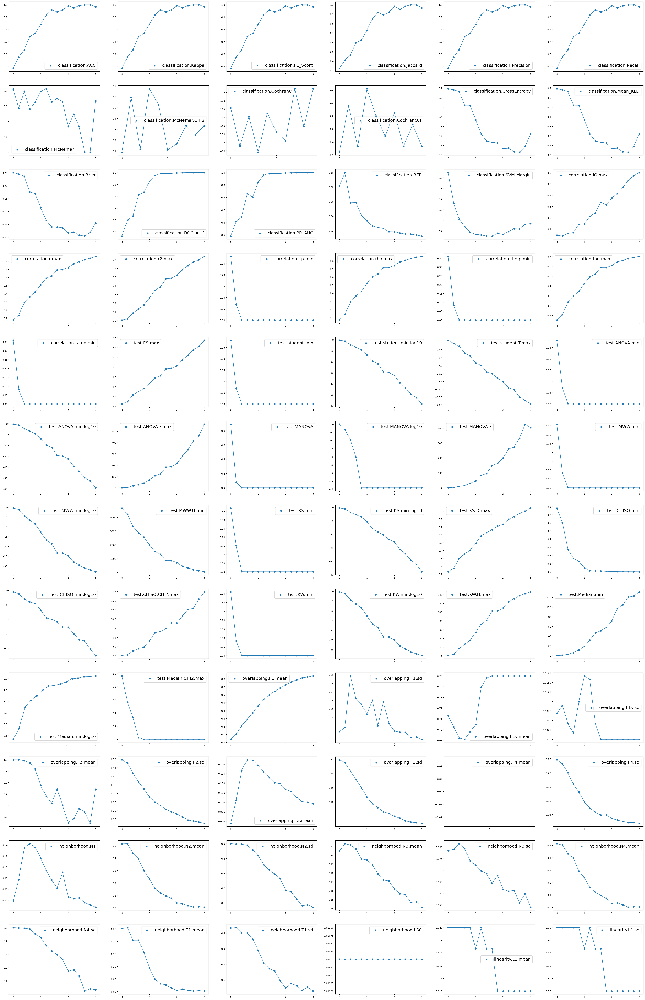

before filter


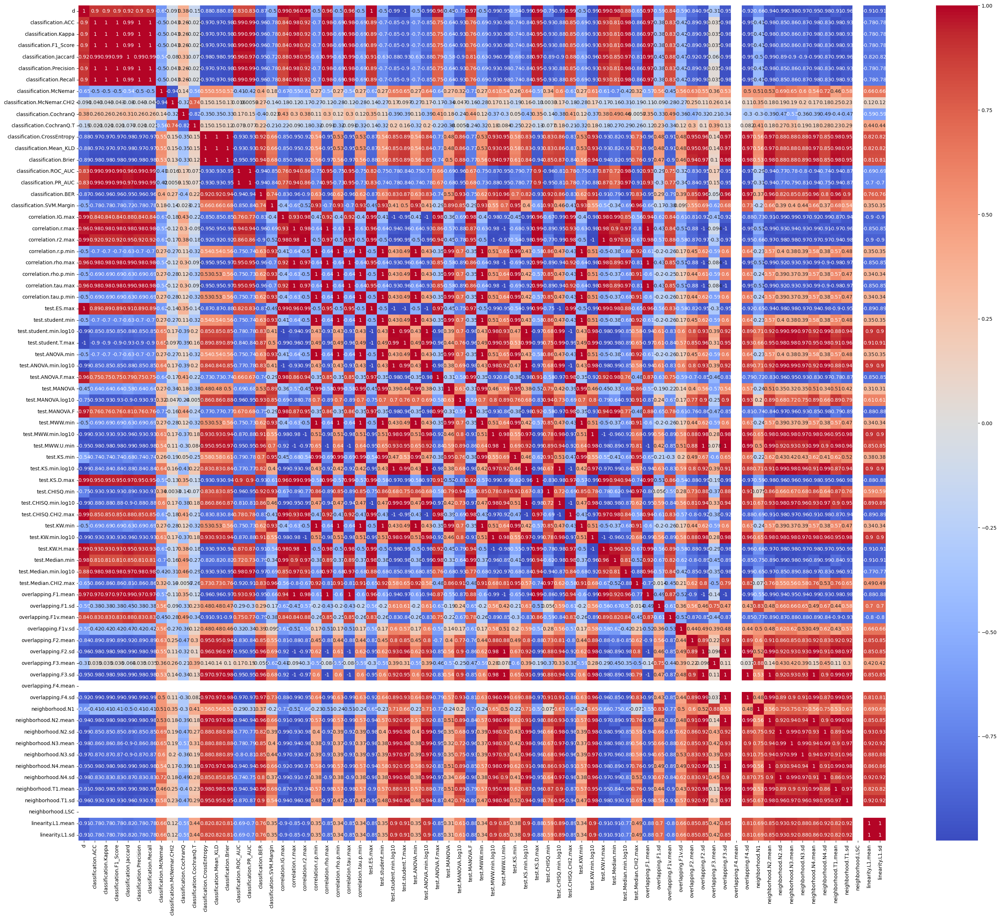

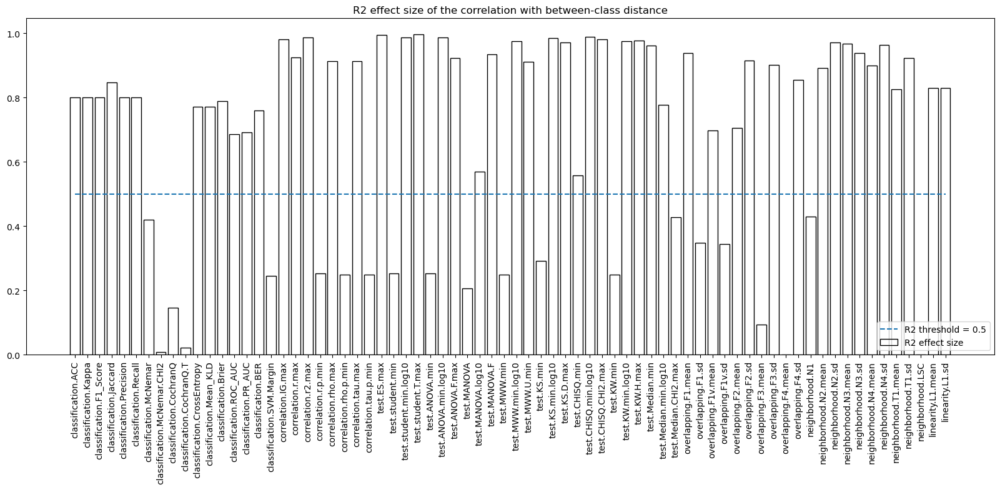

Metrics above the threshold (0.5):  ['classification.ACC' 'classification.Kappa' 'classification.F1_Score'
 'classification.Jaccard' 'classification.Precision'
 'classification.Recall' 'classification.CrossEntropy'
 'classification.Mean_KLD' 'classification.Brier' 'classification.ROC_AUC'
 'classification.PR_AUC' 'classification.BER' 'correlation.IG.max'
 'correlation.r.max' 'correlation.r2.max' 'correlation.rho.max'
 'correlation.tau.max' 'test.ES.max' 'test.student.min.log10'
 'test.student.T.max' 'test.ANOVA.min.log10' 'test.ANOVA.F.max'
 'test.MANOVA.log10' 'test.MANOVA.F' 'test.MWW.min.log10' 'test.MWW.U.min'
 'test.KS.min.log10' 'test.KS.D.max' 'test.CHISQ.min'
 'test.CHISQ.min.log10' 'test.CHISQ.CHI2.max' 'test.KW.min.log10'
 'test.KW.H.max' 'test.Median.min' 'test.Median.min.log10'
 'overlapping.F1.mean' 'overlapping.F1v.mean' 'overlapping.F2.mean'
 'overlapping.F2.sd' 'overlapping.F3.sd' 'overlapping.F4.sd'
 'neighborhood.N2.mean' 'neighborhood.N2.sd' 'neighborhood.N3.mean'
 '

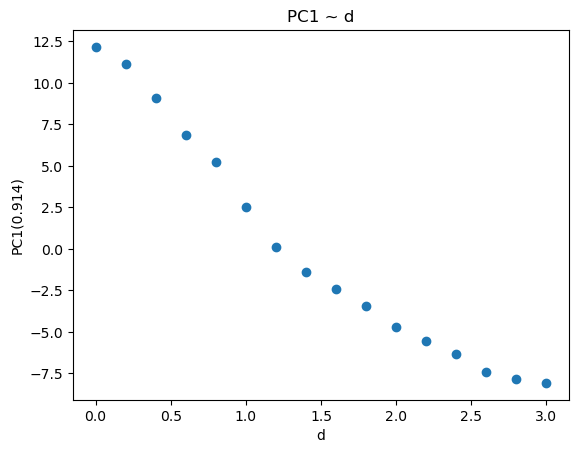

Explained Variance Ratios for the first three PCs [0.91383478 0.05712905 0.01401242]
PC1 before mapping:  -8.356111568398317 [12.638583218857427, 13.19743518741391]
----- End of decompose.pca -----

between-class and in-class scores:
{'meta.logistic': {'umetric_bw': 0.9995913684850687, 'umetric_in': [4.86771458247423e-05, 1.0365532310629803e-06]}, 'decompose.pca': {'umetric_bw': 2.9365776301701563, 'umetric_in': array([0.24867098, 0.23109736])}}



{'GaussianNB()': [1.0], 'DecisionTreeClassifier(max_depth=1)': [1.0], 'RandomForestClassifier(n_estimators=2)': [1.0], "LinearSVC(C=0.01, multi_class='crammer_singer')": [1.0], "LogisticRegressionCV(max_iter=1000, multi_class='multinomial')": [1.0], 'MLPClassifier(hidden_layer_sizes=(11,))': [1.0], 'KNeighborsClassifier(n_neighbors=1)': [1.0], 'LinearDiscriminantAnalysis()': [1.0], 'ELMClassifier(n_hidden_nodes=5)': [1.0], 'RVFLClassifier(n_hidden_nodes=1)': [1.0]}


In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.decomposition import PCA
from qsi import io, pipeline
from cla.unify import analyze
from cla.metrics import run_multiclass_clfs
from IPython.core.display import display, HTML

dics = []
pkls = []

for idx, dataset_id in enumerate(['vintage liquor', 'table salt', 'ovarian cancer', 'covid 19', 'diabetes', 'colorectal cancer', 'iris']):
    
    display(HTML('<h1>Case Study ' + str(idx+1) + ': ' + dataset_id + '</h1><br/>'))
    
    if dataset_id == 'vintage liquor':

        X,y,X_names,_, labels = io.load_dataset('vintage_526', display = False) # salt
        X, X_names = pipeline.preprocess_dataset(X, X_names, pres=[('max', 0.1)])
        
    elif dataset_id == 'table salt':
        X,y,X_names,_, labels = io.load_dataset("salt", x_range=list(range(400,1400)))
        X, X_names = pipeline.preprocess_dataset(X, X_names, pres=[('max', 0.1)])

    elif dataset_id == 'covid 19':
        X, y, X_names, labels = io.open_dataset('covid_and_healthy_spectra.CSV', x_range = list(range(200,600)))
        
        print('Raman spectra of serum from confirmed COVID-19 patients and healthy individuals.')
        labels = ['healthy', 'SARS-CoV-2'] # 当前国际病毒分类委员会将新型冠状病毒的病毒名为SARS-CoV-2，其引起的疾病则被世界卫生组织命名为COVID-19。
        # X, X_names = io.pre.x_binning(X, X_names, target_dim=0.2, flavor='max') # flavor = 'sum'
        io.draw_class_average(X, y, X_names, labels=labels, SD=0, shift=.2)

    elif dataset_id == 'ovarian cancer':
        X, y, X_names, _, labels = io.load_dataset('ovarian_cancer_ms', SD=0, display = False, x_range = list(range(6000,15000)))
        X, X_names = pipeline.preprocess_dataset(X, X_names, pres=[('max', 0.01)]) # , ('baseline_removal', (1e7, 1e-1))
        io.draw_class_average(X, y, X_names, labels=labels, SD=1, shift=1)
        
    elif dataset_id == 'diabetes':
        
        X, y, X_names, labels = io.open_dataset('DM2.CSV' ,x_range = list(range(200,3000)))
        print('Raman spectra of healthy and diabetes II patients. Device is a portable Raman spectrometer (PEK-785, Agiltron Inc.) with a 785 nm, 90 mW laser beam, focused to a spot size of 200 µm. ')
        X, X_names = pipeline.preprocess_dataset(X, X_names, pres = [('baseline_removal', (1e8, 1e-3)),('max', 0.1)]) # 'max', 0.1),
        labels = ['healthy', 'diabetes II'] # spectra of one person's multiple body locations are combined
        io.draw_class_average(X, y, X_names, labels=labels, SD=0, shift=300)
        # io.scatter_plot(X, y, labels)
        
    elif dataset_id == 'colorectal cancer':
        
        print('Raman spectroscopy of different colorectal cancer cell types')
        X, y, X_names, labels = io.open_dataset('SW.CSV' ,x_range = list(range(0,1300)))
        X, X_names = pipeline.preprocess_dataset(X, X_names, pres = [('max', 0.1)]) # ('baseline_removal', (1e7, 1e-1)),
        labels = ['SW480', 'SW620']
        io.draw_class_average(X, y, X_names, labels=labels, SD=0, shift=1)
        
    elif dataset_id == 'iris':
        
        print('the well-known iris dataset')

        # import some data to play with
        iris = datasets.load_iris()
        X = iris.data
        y = iris.target
        
        X = np.vstack((X[y==0], X[y==1]))
        y = np.hstack((y[y==0], y[y==1]))
        X_names = iris.feature_names
        labels = iris.target_names[:2]
    
    io.scatter_plot(X, y, labels)
    
    display(HTML('<h2>Classifiablity Analysis</h2>'))
    
    dic, pkl = analyze(X, y, mds= np.linspace(0, 3, 4+3*4), cutoff=2, filter_threshold=.5, methods=['meta.logistic', 'decompose.pca'], pkl=None, verbose=False)
    dics.append(dic)
    pkls.append(pkl)
    
    display(HTML('<h2>Classification</h2>'))
    dic_clfs, _ = run_multiclass_clfs(X,y,show=False)
    print(dic_clfs)
    
    display(HTML('<hr/><br/>'))

### Data Science Package Version Info

In [ ]:
import sklearn
import scipy
import statsmodels
import seaborn
import numpy
import pandas
import qsi
import cla

print(sklearn.__version__, 
      scipy.__version__,
      statsmodels.__version__, 
      seaborn.__version__, 
      numpy.__version__,
      pandas.__version__,
     qsi.__version__,
     cla.__version__)